<a href="https://colab.research.google.com/github/Risuo/Risuo.github.io/blob/master/train_%26_inference_buildings_model_Mask_RCNN_epochs_70_to_100.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
python3 nucleus.py train --dataset=/path/to/dataset --subset=train --weights=imagenet

In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime → "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Wed Mar  4 18:01:13 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.59       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [2]:
import matplotlib
    # Agg backend runs without a display
#matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import os
import sys
import json
import random
import math
import tensorflow as tf
import re
import time
import datetime
import numpy as np
import skimage.io
from imgaug import augmenters as iaa

from PIL import Image as PImage

# Root directories of the project
sys.path.append('/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/')
sys.path.append('/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/datasets')
sys.path.append('/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/samples/nucleus')
sys.path.append('/content/drive/My Drive/Capstone/Open Cities Competition')

# Import Mask RCNN
from mrcnn.config import Config
from mrcnn import utils
from mrcnn import model as modellib
from mrcnn import visualize
from mrcnn.visualize import display_images
from mrcnn.model import log

# Path to trained weights file
COCO_WEIGHTS_PATH = '/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/samples/coco/mask_rcnn_coco.h5'

# Directory to save logs and model checkpoints, if not provided
# through the command line argument --logs
DEFAULT_LOGS_DIR = '/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/logs'

DATASET_DIR = '/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/datasets/building/train_4992_a'

VALIDSET_DIR = '/content/drive/My Drive/Capstone/Open Cities Competition/Test Data/test'

# Results directory
# Save submission files here
RESULTS_DIR = '/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/results/buildings'


VAL_IMAGE_IDS = [
    "odgixRzV2A9GsOWR7yGWkDcf7AdHxrlvfFcFG8qxpE4",
    "VEl6kup9pAiTOc9B1tKDHRMeH_29SBUSxu0fszDG0AE",
    "1R61DUW5uy-zAk2LBaphg8Bkf1mRKtcSArkiYdq4OQY",
    "IFMWSI3D90Lw3rlpNXCEsYI319smfXVL_eX4tU8tO0k",
    "pnS55lLg0IfAU-hYZ_ZUtIi_JI01IfTGIBa2SVBu1Q8",
    "Bw8jQAP34TQXr3bVk5eN68PmO4JSZSs7FOLhy6_qEGc",
    "ah7Uj2f96DqSNwKF4rctoBYaGKy7m09EWC-PCosatP8",
    "kAJktpApTOXDz42HtqD84r9Erp0ywpX-tq0GXlbvclQ",
    "lRpMfzTum0fo_8vXO98TUPqBoF84VlFG7_CTA1aRG1c",
    "hEmgOrgKazUyqV9Wfx_pXgIRE-h9AVfKxlUJ0dAci4U",
    "bz3b3EPA910x4uHAzCr_dxAPkGnZhMM8VLCwOAEVP_s",
    "BrQSQ837Yl_BROM9BXPaJkOpsQ-YxzuFdVh4qwhqyhg",
    "FINAnjR_r-IdB3c5hPBKxRuz46rDOdEjzUnyxC4t5Ws",
    "TmIKIiMWHRhU3MqisV0kfcbpAaso-xf52WiSyK3_cK0",
    "EyXp4nx5wb8ML6gZC93-9Y0HGBvYhIMBsFJoL4VeYyk",
    "z-TDdPq2NxbziZPghieSUfJRudZd4T48_5yjEdzJHHY",
    "gUc9_ugIlVCAyR2ZG6zgdFxvtudnxYWpiB0ILd2uKmM",
    "wvgqUNsK28DRYGFzcxE0ieh9FkkLp53J0uFQH5nSe-g",
    "6tQhEr-tsCRD_QltXn-kYkksjGB9Xncp0R1Bfx53g0Q",
    "OqNSRiRLQNfARl2GpKjVbmJMIEPMUuVHsmhD-ehpvy0",
    "Kl7XMzPG-gcNKMSfhwDXTceblkI0PRNtobSiUiInAW8",
    "tsB4NtP3CSvwztX8b_c2BKojqScxj9XzwBuqtjxowYE",
    "qV9JxMyLl2rKX9R7zNHAD_QvRI31aJFgPsBdutl54nE",
    "YkyiW3h9pFI2z51m30Hn62tQkFXEhPiW9QNHfbGM0q4",
    "-TEd7R2IMDmlAHSEuAvaCLUDeLRgay_pXMYRZyo8Vrw",
    
    "hu0czuUunWp9lSTn6oU-_bJ10KmxjDA1tS1Sv2Q-vVc",
    "fM2TKRC2E1Vqi7IJRk_c2dc8cuYLVt1TMNRntB34HEc",
    "zbYiS6A8fHMoRuLM5RWSULgoLywGCETCA9hA_sPIRUo",
    "10d-iLSW7q48bbay8-ot5LU73u0hunG1pYDQohqhO7Q",
    "2Aa9k4b5ri7dxvfazeCr3wbNae4rUZvuvGtE4HMqwqI",
    "hnx0HPEJaTnM8Sjh18bc1b1rZ5-gcwgqUvnRjgtgXpo",
    "pAsVdEXtzGU4bveSiN_uguPLjJbxOeRmGJt2-syrrFg",
    "fwziasPjOV7NYIIbNNaL0s4iA5awsshJ1KIKawIhbwk",
    "HOU8FafTUEXqi75AdWT9-GmPiIBAPJZQv58aWpWtORE",
    "CUfijT5J8VPS47yhpr8JJvgFT7bBXYqKiUrlUESKlAM",
    "mA2o1XlSkSoHwl-11UEqWSVhzCsvXmR1dttE4LaJ9v4",
    "IgH7ILS3NwYzPyqb0DleVzDDw9Z4wohnh_WOyPsyBuQ",
    "pZLVtfyEVlMh-lTarBHpninXlVlTQxlZHPfzGpuYeHo",
    "KMnsLi1dG5UxIqoW3j5ri0Pt2zlj1uap5-McWT3dNRQ",
    "TwQ96OJT4JAU_7LLvwbgqmmNzXbuMWQ8G5opTtJdlb8",
    "JPdbmvSZI7hB8OH4YAWOFeQfVQ1Suf68QSc8L1x915g",
    "ie0Q9KZlX-iHJPwY74x_qNe2XUuBCxBdPq46lrCGzG0",
    "tIbHqEV_L5YFfRTVoH3mUd__NFmJ6P7zT7mGIM7zvdY",
    "_FNnlJ0JzusnzGMAftAIiqnm42QZlVqmJYbjYewaju4",
    "tg_atu0wvm17jNGE3CZ9cKPIoFItpcZ_nkkZggarCfU",
    "8XPnJpvRb5t1RTtYyUF9rBQ32Av3zst4h_Tf4siu3ro",
    "Uux4v-A1grv9kZEKC6Ed9u0ZRolGAVz0QABvSopXhac",
    "NnLoOn2PUrUsFqUN1DakSBcuvMzDU8OOD2y7Ny14buE",
    "DIpo3K5McQVxt1oD4doOPYi0GWEsZ8iinfR_9_BbVL0",
    "iYVfpYjqS5YRwitL4uN94yetS-bbWYc63AQWdlBzntU"
    ]


Using TensorFlow backend.


############################################################
#  Configurations
############################################################


In [0]:
class BuildingsConfig(Config):
    """Configuration for training on the toy shapes dataset.
    Derives from the base Config class and overrides values specific
    to the toy shapes dataset.
    """
    # Give the configuration a recognizable name
    NAME = "buildings"

    # Train on 1 GPU and 8 images per GPU. We can put multiple images on each
    # GPU because the images are small. Batch size is 8 (GPUs * images/GPU).
    GPU_COUNT = 1
    IMAGES_PER_GPU = 6

    # Number of classes (including background)
    NUM_CLASSES = 1 + 1  # background + 1 shapes

    # Number of training and validation steps per epoch
    STEPS_PER_EPOCH = (1990 - len(VAL_IMAGE_IDS)) // IMAGES_PER_GPU
    VALIDATION_STEPS = max(1, len(VAL_IMAGE_IDS) // IMAGES_PER_GPU)

    # Don't exclude based on confidence. Since we have two classes
    # then 0.5 is the minimum anyway as it picks between building and BG
    DETECTION_MIN_CONFIDENCE = 0

    # Backbone network architecture
    # Supported values are: resnet50, resnet101
    BACKBONE = "resnet101"

    # Input image resizing
    # Random crops of size 512x512
    IMAGE_RESIZE_MODE = "none"
    IMAGE_MIN_DIM = 512
    IMAGE_MAX_DIM = 512
    IMAGE_MIN_SCALE = 0

    # Length of square anchor side in pixels
    RPN_ANCHOR_SCALES = (16, 32, 64, 128, 256)

    # ROIs kept after non-maximum supression (training and inference)
    POST_NMS_ROIS_TRAINING = 2000
    POST_NMS_ROIS_INFERENCE = 6000

    # Non-max suppression threshold to filter RPN proposals.
    # You can increase this during training to generate more propsals.
    RPN_NMS_THRESHOLD = 0.8

    # How many anchors per image to use for RPN training
    RPN_TRAIN_ANCHORS_PER_IMAGE = 128

    # Image mean (RGB)
    # This is taken from the data inspection np.mean(image_color, axis=0) result
    MEAN_PIXEL = np.array([128.77, 118.85, 99.54])

    # If enabled, resizes instance masks to a smaller size to reduce
    # memory load. Recommended when using high-resolution images.
    USE_MINI_MASK = True
    MINI_MASK_SHAPE = (112, 112)  # (height, width) of the mini-mask

    # Number of ROIs per image to feed to classifier/mask heads
    # The Mask RCNN paper uses 512 but often the RPN doesn't generate
    # enough positive proposals to fill this and keep a positive:negative
    # ratio of 1:3. You can increase the number of proposals by adjusting
    # the RPN NMS threshold.
    # The data inspection used 32 here, so possibly revert
    TRAIN_ROIS_PER_IMAGE = 64

    # Maximum number of ground truth instances to use in one image
    MAX_GT_INSTANCES = 100

    # Max number of final detections per image
    DETECTION_MAX_INSTANCES = 200

    # Non-maximum suppression threshold for detection
    DETECTION_NMS_THRESHOLD = 0.3


In [0]:
def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

############################################################
#  Dataset
############################################################

In [0]:
import secrets
from PIL import Image
from collections import defaultdict
import shapely.affinity
import cv2
from shapely.geometry import Polygon, MultiPolygon

def mask_to_polygons(mask, epsilon=1, min_area=10.):
    # __author__ = Konstantin Lopuhin
    # https://www.kaggle.com/lopuhin/dstl-satellite-imagery-feature-detection/full-pipeline-demo-poly-pixels-ml-poly

    # first, find contours with cv2: it's much faster than shapely
    # image, (remove from original) 
    contours, hierarchy = cv2.findContours(
        ((mask == 1) * 255).astype(np.uint8),
        cv2.RETR_CCOMP, cv2.CHAIN_APPROX_TC89_KCOS)
    # create approximate contours to have reasonable submission size
    approx_contours = [cv2.approxPolyDP(cnt, epsilon, True)
                       for cnt in contours]
    if not contours:
        return MultiPolygon()
    # now messy stuff to associate parent and child contours
    cnt_children = defaultdict(list)
    child_contours = set()
    assert hierarchy.shape[0] == 1
    # http://docs.opencv.org/3.1.0/d9/d8b/tutorial_py_contours_hierarchy.html
    for idx, (_, _, _, parent_idx) in enumerate(hierarchy[0]):
        if parent_idx != -1:
            child_contours.add(idx)
            cnt_children[parent_idx].append(approx_contours[idx])
    # create actual polygons filtering by area (removes artifacts)
    all_polygons = []
    for idx, cnt in enumerate(approx_contours):
        if idx not in child_contours and cv2.contourArea(cnt) >= min_area:
            assert cnt.shape[1] == 1
            poly = Polygon(
                shell=cnt[:, 0, :],
                holes=[c[:, 0, :] for c in cnt_children.get(idx, [])
                       if cv2.contourArea(c) >= min_area])
            all_polygons.append(poly)
    # approximating polygons might have created invalid ones, fix them
    all_polygons = MultiPolygon(all_polygons)
    if not all_polygons.is_valid:
        all_polygons = all_polygons.buffer(0)
        # Sometimes buffer() converts a simple Multipolygon to just a Polygon,
        # need to keep it a Multi throughout
        if all_polygons.type == 'Polygon':
            all_polygons = MultiPolygon([all_polygons])
    return all_polygons

def group_of_polygons(polygon_group, im_size):
    polygon_mask_group = []
    polygons = [polygon_group.geoms[a] for a in range(len(polygon_group.geoms))]
    #polygons = list(polygons)
    for _ in polygons:
        img_mask = np.zeros([im_size, im_size], np.uint8)
        if not polygons:
            return img_mask
        int_coords = lambda x: np.array(x).round().astype(np.int32)
        exterior = int_coords(_.exterior.coords)
        interior = [int_coords(pi.coords) for pi in _.interiors]
        if len(interior) == 0:
            cv2.fillConvexPoly(img_mask, exterior, 1)
            cv2.fillPoly(img_mask, interior, 0)
        else:
            cv2.fillConvexPoly(img_mask, exterior, 1)
            cv2.fillPoly(img_mask, interior, 0)
        polygon_mask_group.append(img_mask)
    return polygon_mask_group

def convert_dataset_to_files(x_set, y_set, folder_dir):
    print('Converting:', len(x_set), ':files.')
    for _ in range(len(x_set)):
        x_file = x_set[_]
        y_file = y_set[_]
        name = secrets.token_urlsafe(32)
        if not os.path.exists(folder_dir + '/' + name):
            os.makedirs(folder_dir + '/' + name)
        if not os.path.exists(folder_dir + '/' + name + '/' + 'image'):
            os.makedirs(folder_dir + '/' + name + '/' + 'image')
        if not os.path.exists(folder_dir + '/' + name + '/' + 'masks'):
            os.makedirs(folder_dir + '/' + name + '/' + 'masks')

        np.save(folder_dir + '/' + name + '/' + 'image' + '/' + name, x_file)
        
        # Split whole-image-mask into individual building masks
        msk = mask_to_polygons(y_file)
        msk = group_of_polygons(msk, 512)
        if _ % 250 == 0:
            print('file shapes:', _, x_file.shape, y_file.shape)
            print('discrete masks:', _, len(msk))
        for mask in msk:
            submask_name = secrets.token_urlsafe(32)
            np.save(folder_dir + '/' + name + '/' + 'masks' + '/' + submask_name, mask)

def create_buildings_dataset(x_train_dir, y_train_dir, folder_dir):
    print('loading datasets...')
    x_trn = np.load(x_train_dir)
    y_trn = np.load(y_train_dir)
    print('datasets loaded!')
    convert_dataset_to_files(x_trn, y_trn, folder_dir)

folder_dir = '/content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/datasets/building/val_128_a'
x_train_dir = '/content/drive/My Drive/Capstone/Open Cities Competition/Detectron2/datasets/original .npy files/128_x_trn_2_512.npy'
y_train_dir = '/content/drive/My Drive/Capstone/Open Cities Competition/Detectron2/datasets/original .npy files/128_y_trn_2_512.npy'

In [0]:
create_buildings_dataset(x_train_dir*, y_train_dir*, folder_dir*)

loading datasets...
datasets loaded!
Converting: 128 :files.
file shapes: 0 (512, 512, 3) (512, 512, 1)
discrete masks: 0 5


In [0]:
class BuildingDataset(utils.Dataset):

    def load_building(self, dataset_dir, subset):
        
        self.add_class("building", 1, "building")

        assert subset in ["train", "val"]

        # Get image ids from directory names
        # At this point, initial test, we're using a sub-set of 50 images as the
        # validation dataset. Eventually we will create a second dataset to be
        # exclusively used as the validation dataset. At that point, this code
        # will have to be updated
        # TODO: Update method to select proper directories for train/val subsets 
        if subset == 'val':
            image_ids = VAL_IMAGE_IDS
        else:
            image_ids = next(os.walk(dataset_dir))[1]
            if subset == 'train':
                image_ids = list(set(image_ids) - set(VAL_IMAGE_IDS))

        # Add the images
        for image_id in image_ids:
            self.add_image("building",
                           image_id = image_id,
                           path=os.path.join(dataset_dir, image_id, "image/{}.npy".format(image_id)))

    def load_tiff_image(self, image_df, image_id):
        # Created to process the Open Cities challenge test dataset. Requires test_df object (image_df)
        # and image_id (to be run as an iteration x times, in the case of submission, use len(test_df))

        im = PImage.open(image_df.fn.values[image_id])
        image = np.array(im)[:, :, 0:3]
        print(image.shape)
        return image
        
    def load_image(self, image_id):
        """Load the specified image and return a [H,W,3] Numpy array.
        """
        # Load image
        image = np.load(self.image_info[image_id]['path'])
        # If grayscale. Convert to RGB for consistency.
        if image.ndim != 3:
            image = skimage.color.gray2rgb(image)
        # If has an alpha channel, remove it for consistency
        if image.shape[-1] == 4:
            image = image[..., :3]
        return image

    def load_mask(self, image_id):
        """Generate instance masks for an image.
       Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        info = self.image_info[image_id]
        # Get mask directory from image path
        mask_dir = os.path.join(os.path.dirname(os.path.dirname(info['path'])), "masks")

        # Read mask files from .png image
        mask = []
        for f in next(os.walk(mask_dir))[2]:
            if f.endswith(".npy"):
                m = np.load(os.path.join(mask_dir, f))
                mask.append(m)
        mask = np.stack(mask, axis=-1)
        # Return mask, and array of class IDs of each instance. Since we have
        # one class ID, we return an array of ones
        return mask, np.ones([mask.shape[-1]], dtype=np.int32)

    def image_reference(self, image_id):
        """Return the path of the image."""
        info = self.image_info[image_id]
        if info["source"] == "building":
            return info["id"]
        else:
            super(self.__class__, self).image_reference(image_id)

############################################################
#  Training
############################################################

In [0]:
def train(model, dataset_dir, subset): # set subset as 'train' 
    """Train the model."""
    # Training dataset.
    dataset_train = BuildingDataset()
    dataset_train.load_building(dataset_dir, subset)
    dataset_train.prepare()

    # Validation dataset
    dataset_val = BuildingDataset()
    dataset_val.load_building(dataset_dir, "val")
    dataset_val.prepare()

    # Image augmentation
    # We won't be using this since the images are already augmented. However, 
    # It may make sense to remove the agumentation as it currently stands,
    # And tranfer it over to this point. 
    # Initially, we're just commenting out the augmentation portion, as shown
    # below. 
    # http://imgaug.readthedocs.io/en/latest/source/augmenters.html
    augmentation = iaa.SomeOf((0, 2), [
        iaa.Fliplr(0.5),
        iaa.Flipud(0.5),
        iaa.OneOf([iaa.Affine(rotate=90),
                   iaa.Affine(rotate=180),
                   iaa.Affine(rotate=270)]),
        iaa.Multiply((0.8, 1.5)),
        iaa.GaussianBlur(sigma=(0.0, 5.0))
    ])

    # *** This training schedule is an example. Update to your needs ***

    # If starting from imagenet, train heads only for a bit
    # since they have random weights
    print("Train network heads")
    model.train(dataset_train, dataset_val,
                learning_rate=config.LEARNING_RATE,
                epochs=70,
                augmentation=augmentation,
                layers='heads')

    print("Train all layers")
    model.train(dataset_train, dataset_val,
                learning_rate=config.LEARNING_RATE,
                epochs=100,
                augmentation=augmentation,
                layers='all')

############################################################
#  RLE Encoding
############################################################

In [0]:
def rle_encode(mask):
    """Encodes a mask in Run Length Encoding (RLE).
    Returns a string of space-separated values.
    """
    assert mask.ndim == 2, "Mask must be of shape [Height, Width]"
    # Flatten it column wise
    m = mask.T.flatten()
    # Compute gradient. Equals 1 or -1 at transition points
    g = np.diff(np.concatenate([[0], m, [0]]), n=1)
    # 1-based indicies of transition points (where gradient != 0)
    rle = np.where(g != 0)[0].reshape([-1, 2]) + 1
    # Convert second index in each pair to lenth
    rle[:, 1] = rle[:, 1] - rle[:, 0]
    return " ".join(map(str, rle.flatten()))


def rle_decode(rle, shape):
    """Decodes an RLE encoded list of space separated
    numbers and returns a binary mask."""
    rle = list(map(int, rle.split()))
    rle = np.array(rle, dtype=np.int32).reshape([-1, 2])
    rle[:, 1] += rle[:, 0]
    rle -= 1
    mask = np.zeros([shape[0] * shape[1]], np.bool)
    for s, e in rle:
        assert 0 <= s < mask.shape[0]
        assert 1 <= e <= mask.shape[0], "shape: {}  s {}  e {}".format(shape, s, e)
        mask[s:e] = 1
    # Reshape and transpose
    mask = mask.reshape([shape[1], shape[0]]).T
    return mask


def mask_to_rle(image_id, mask, scores):
    "Encodes instance masks to submission format."
    assert mask.ndim == 3, "Mask must be [H, W, count]"
    # If mask is empty, return line with image ID only
    if mask.shape[-1] == 0:
        return "{},".format(image_id)
    # Remove mask overlaps
    # Multiply each instance mask by its score order
    # then take the maximum across the last dimension
    order = np.argsort(scores)[::-1] + 1  # 1-based descending
    mask = np.max(mask * np.reshape(order, [1, 1, -1]), -1)
    # Loop over instance masks
    lines = []
    for o in order:
        m = np.where(mask == o, 1, 0)
        # Skip if empty
        if m.sum() == 0.0:
            continue
        rle = rle_encode(m)
        lines.append("{}, {}".format(image_id, rle))
    return "\n".join(lines)

############################################################
#  Detection
############################################################

In [0]:
def building_detect(model, image_id, test_df=test_df):
    """Run detection on images in the given directory."""

    # Load over images
    #submission = []
    # Load image and run detection
    image_id = image_id
    #image = dataset.load_image(image_id)
    image = dataset.load_tiff_image(test_df, image_id)
    #print(image)
    # Detect objects
    r = model.detect([image], verbose=0)[0]
    # Encode image to RLE. Returns a string of multiple lines
    source_id = dataset.image_info[image_id]["id"]
    #print(r)
    #print(r['scores'])

    #rle = mask_to_rle(source_id, r["masks"], r["scores"])
    #print(r["masks"].shape)
    #submission.append(rle)
    # Save image with masks
    visualize.display_instances(
        image, r['rois'], r['masks'], r['class_ids'],
        dataset.class_names, r['scores'],
        show_bbox=False, show_mask=True,
        title="Predictions")
    

In [0]:
def detect(model, dataset_dir, subset):
    """Run detection on images in the given directory."""
    print("Running on {}".format(dataset_dir))

    for image_id in dataset.image_ids:
        # Load image and run detection
        image = dataset.load_image(image_id)
        # Detect objects
        r = model.detect([image], verbose=0)[0]
        # Encode image to RLE. Returns a string of multiple lines
        source_id = dataset.image_info[image_id]["id"]
        rle = mask_to_rle(source_id, r["masks"], r["scores"])
        # Save image with masks
        visualize.display_instances(
            image, r['rois'], r['masks'], r['class_ids'],
            dataset.class_names, r['scores'],
            show_bbox=False, show_mask=False,
            title="Predictions")


In [0]:
config = BuildingsInferenceConfig()

In [58]:
config = BuildingsInferenceConfig()
#config.display()

dataset = BuildingDataset()
dataset.load_building(DATASET_DIR, "val")
dataset.prepare()

model = modellib.MaskRCNN(mode="inference",
                            model_dir=DEFAULT_LOGS_DIR,
                            config=config)

weights_path = model.find_last()

# Load weights
print("Loading weights ", weights_path)
model.load_weights(weights_path, by_name=True)

Loading weights  /content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/logs/buildings20200302T1637/mask_rcnn_buildings_0100.h5
Re-starting from epoch 100


(1024, 1024, 3)


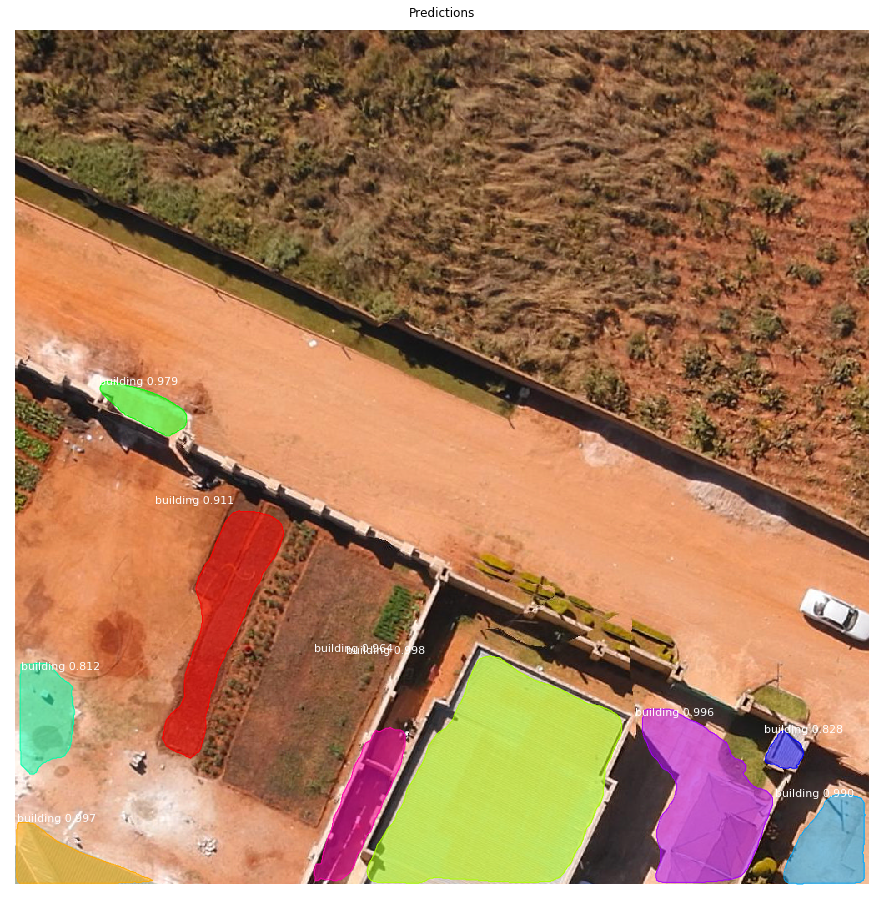

(1024, 1024, 3)

*** No instances to display *** 



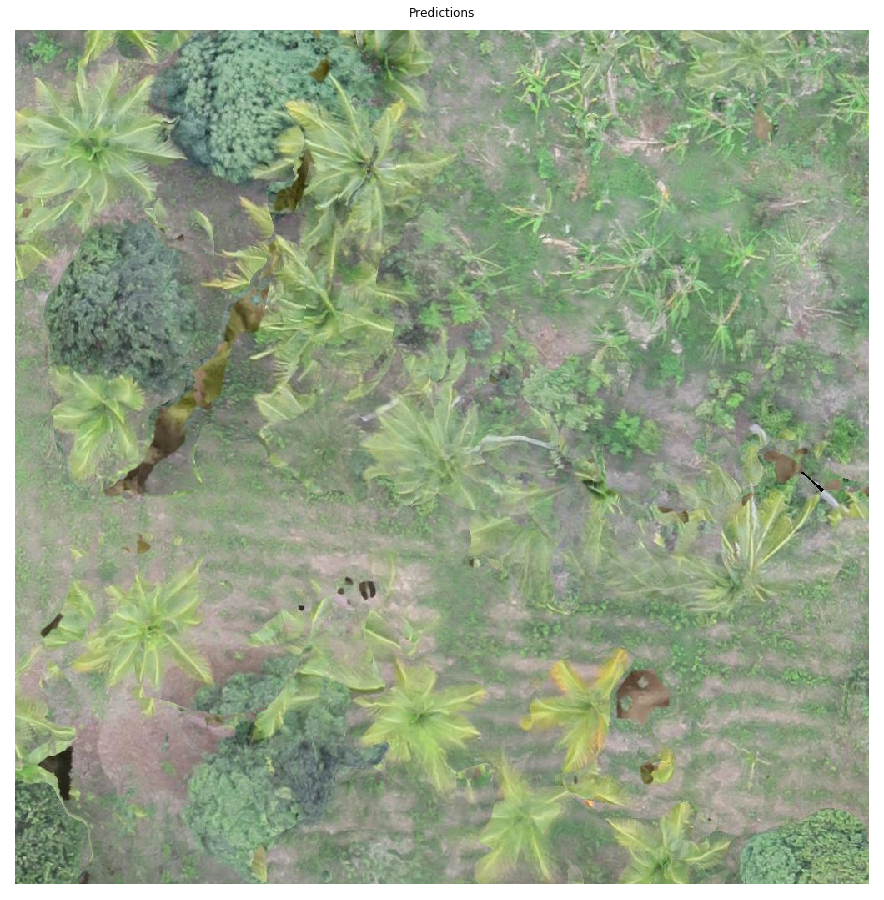

(1024, 1024, 3)


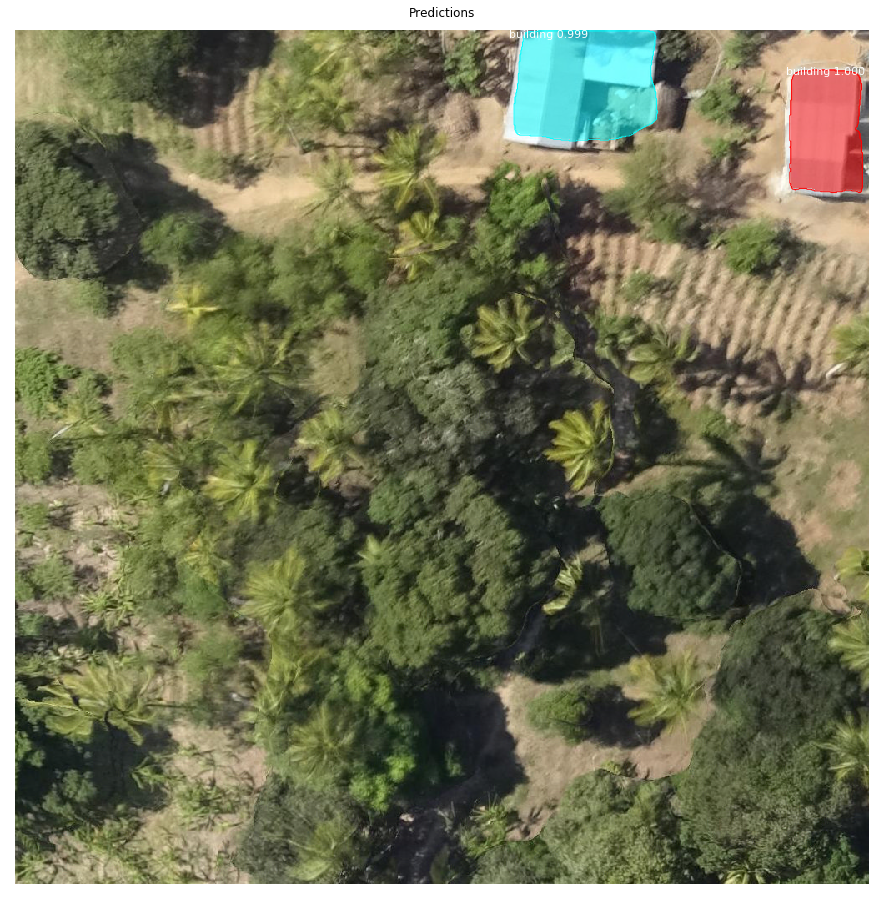

(1024, 1024, 3)

*** No instances to display *** 



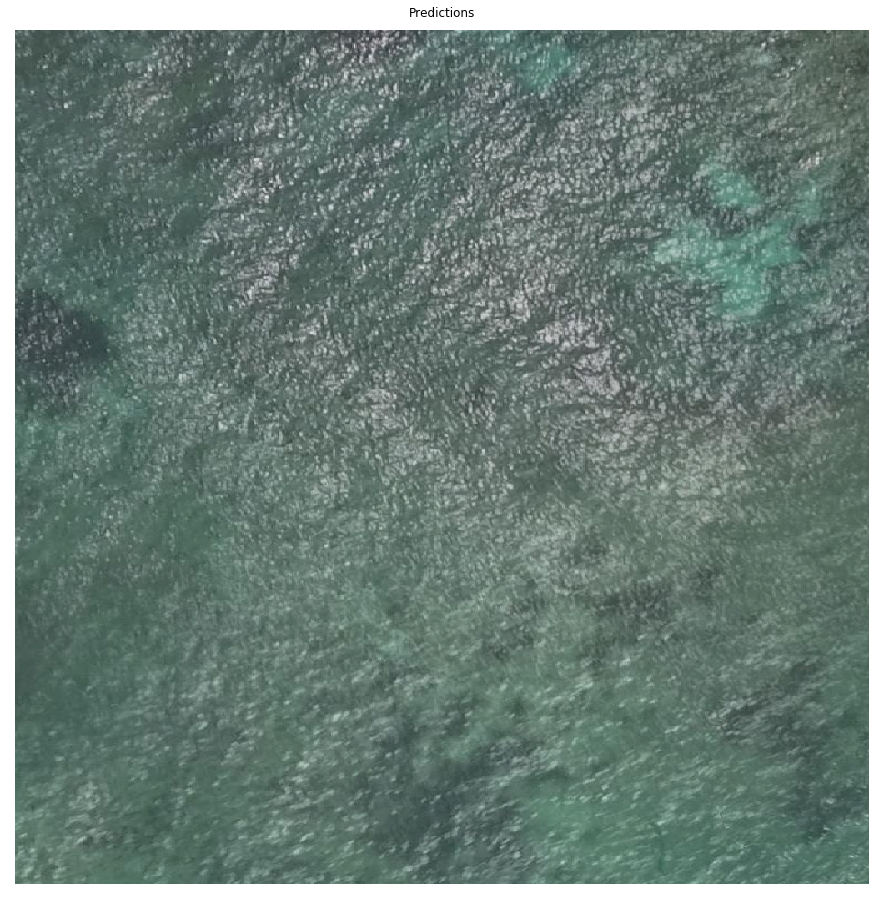

(1024, 1024, 3)


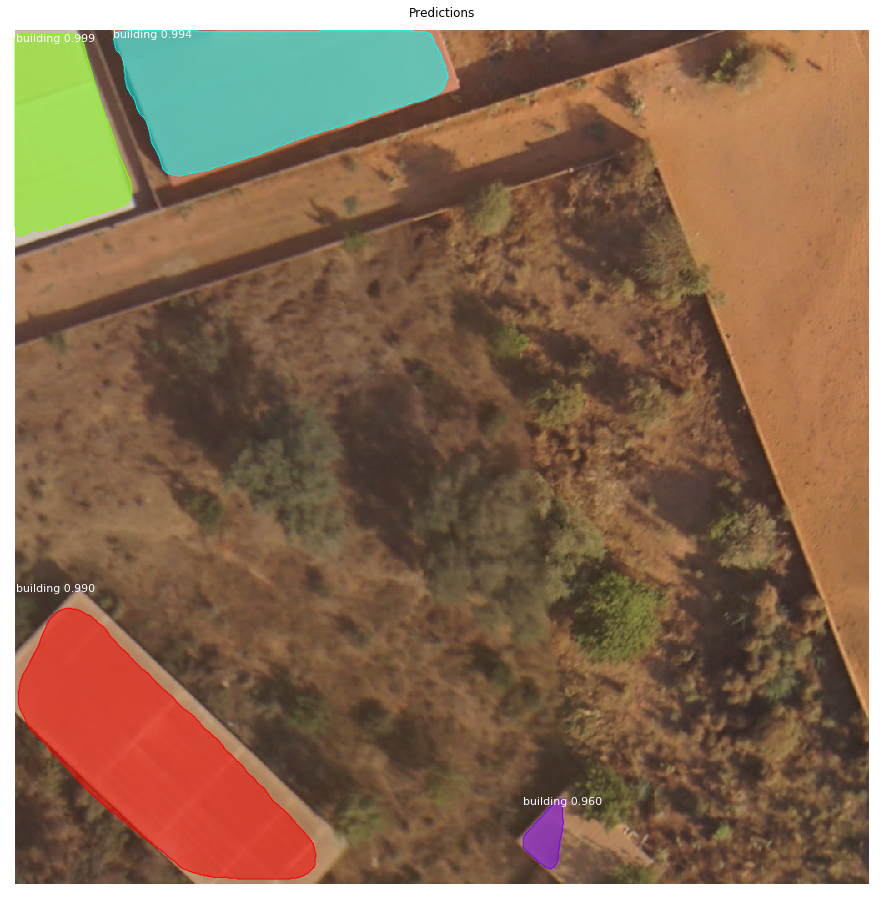

(1024, 1024, 3)

*** No instances to display *** 



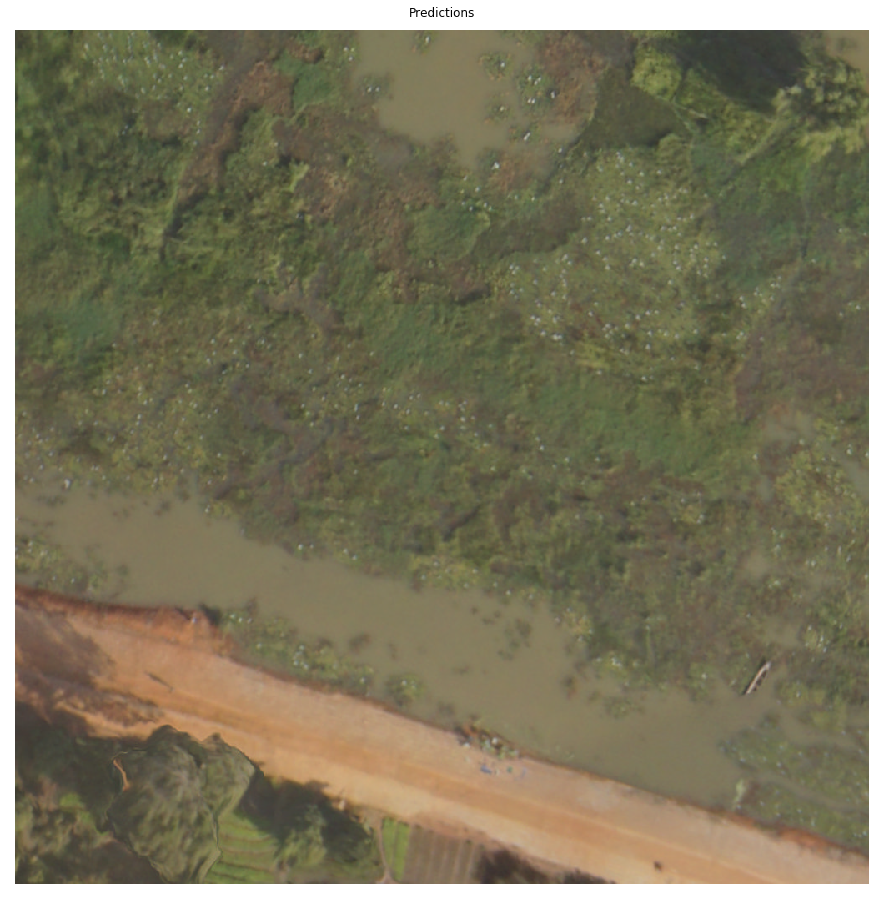

(1024, 1024, 3)


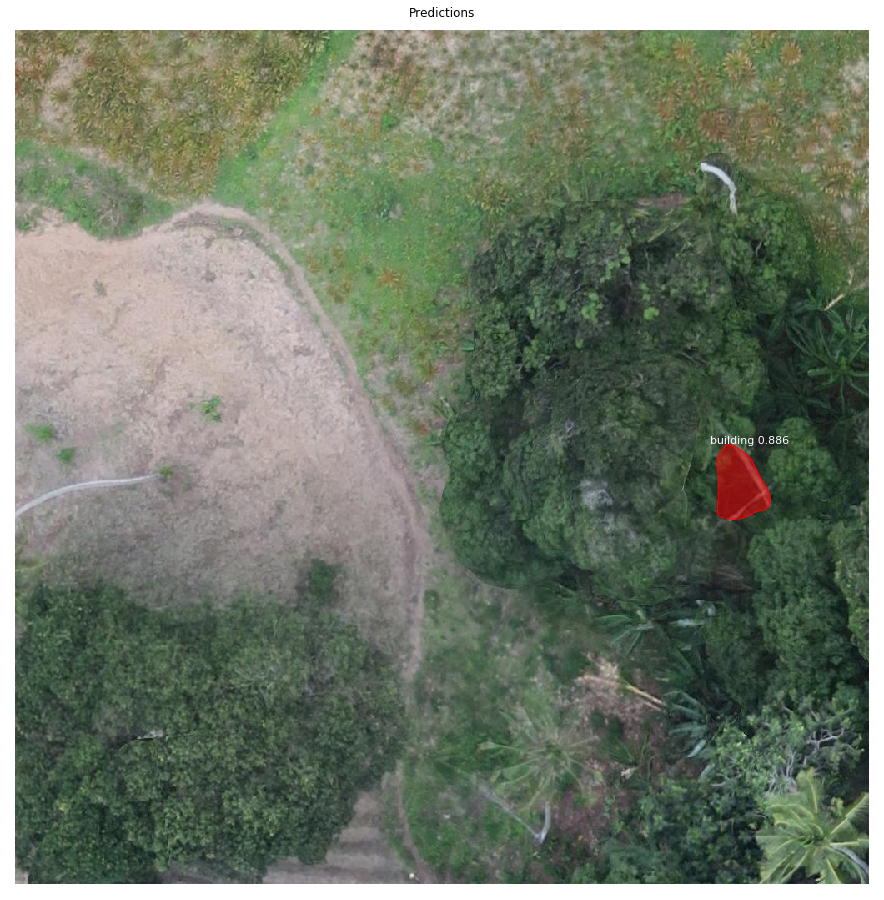

(1024, 1024, 3)


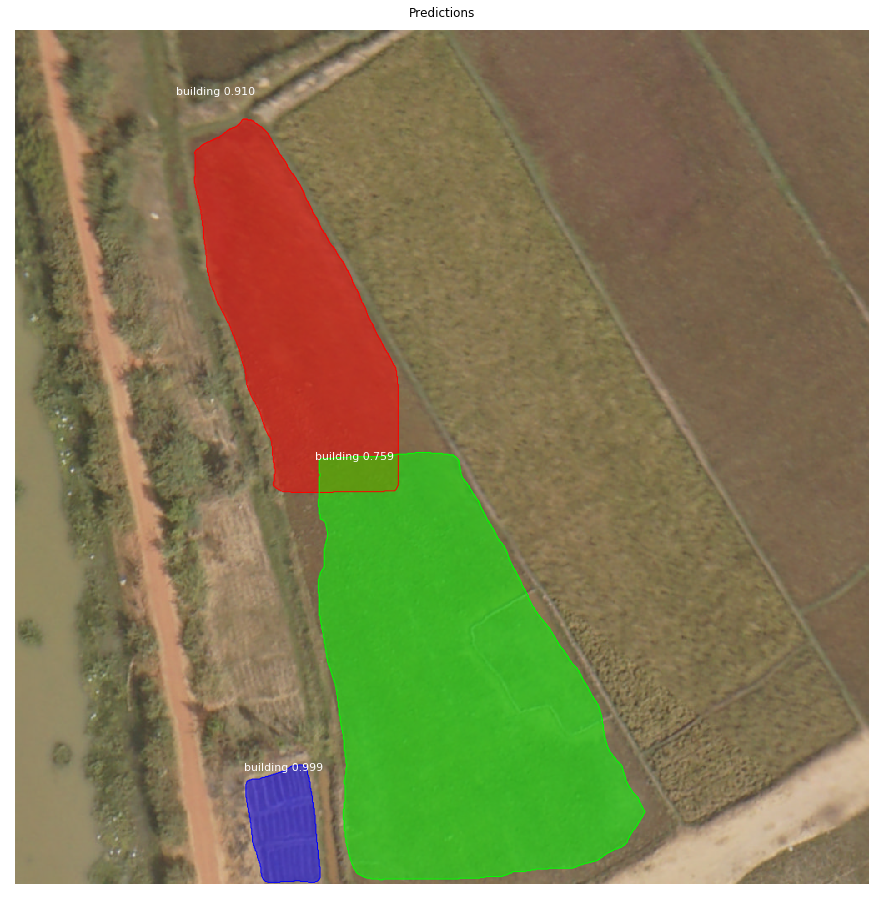

(1024, 1024, 3)


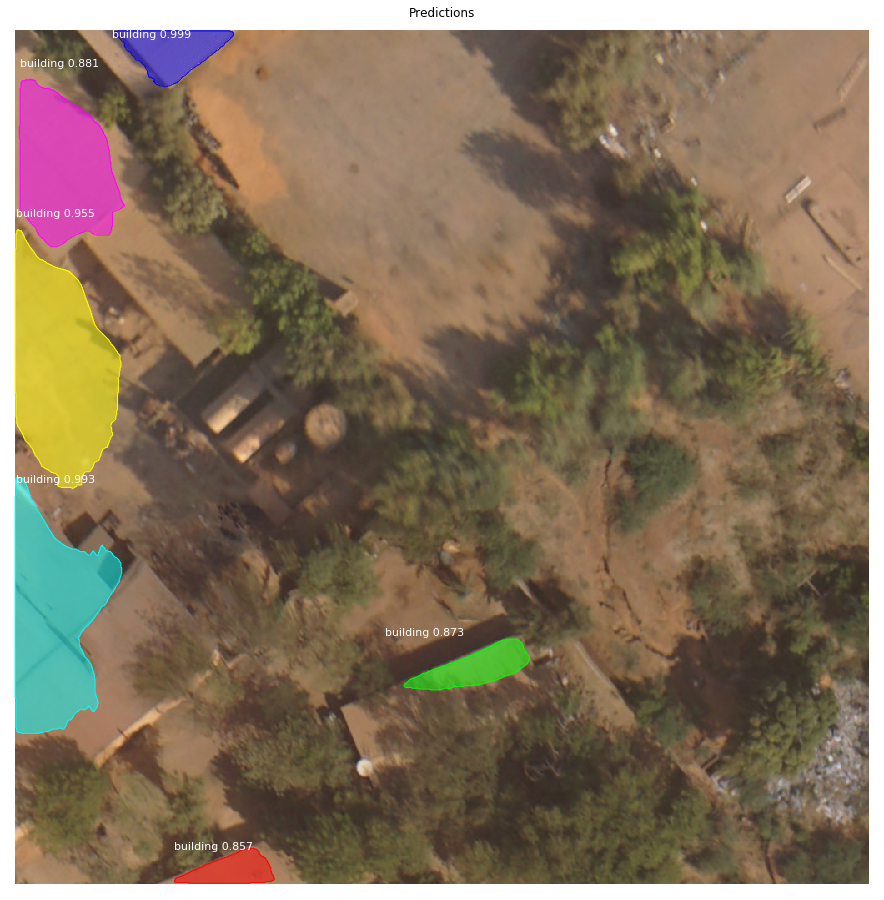

(1024, 1024, 3)

*** No instances to display *** 



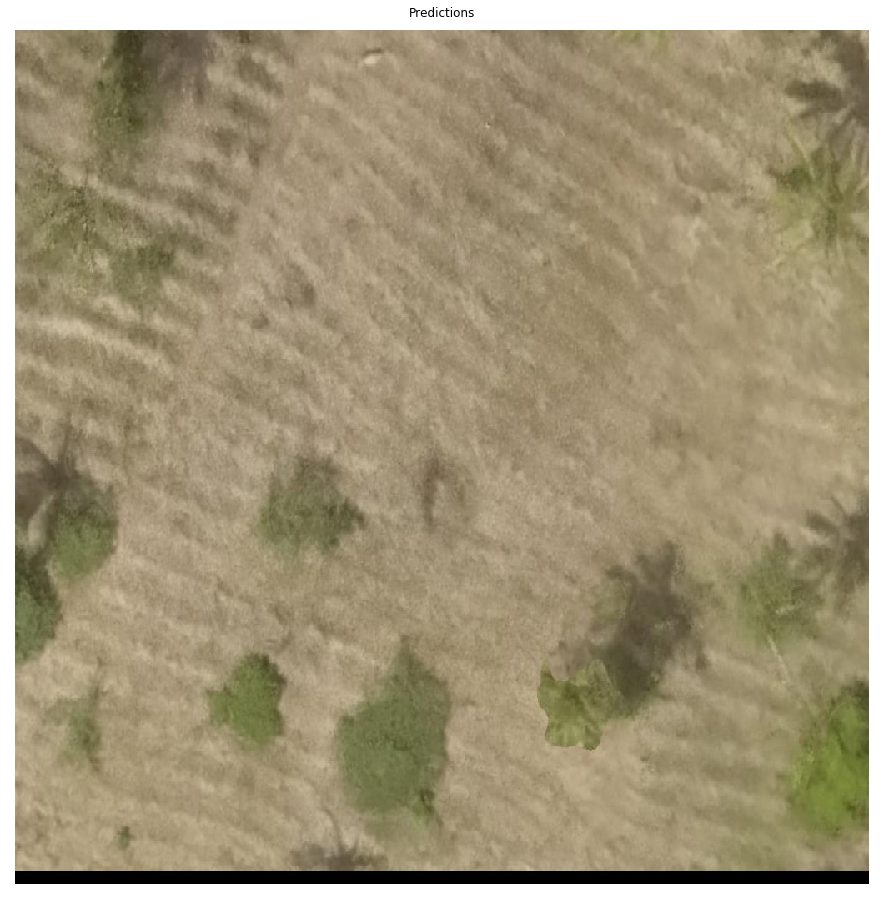

(1024, 1024, 3)


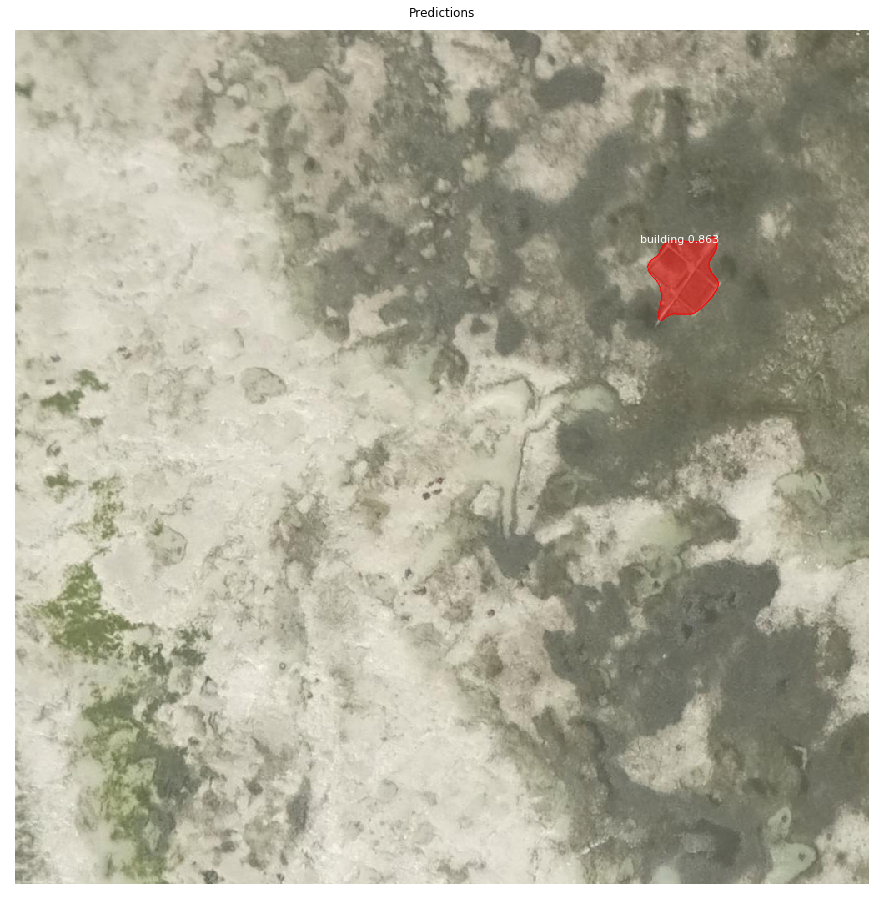

(1024, 1024, 3)


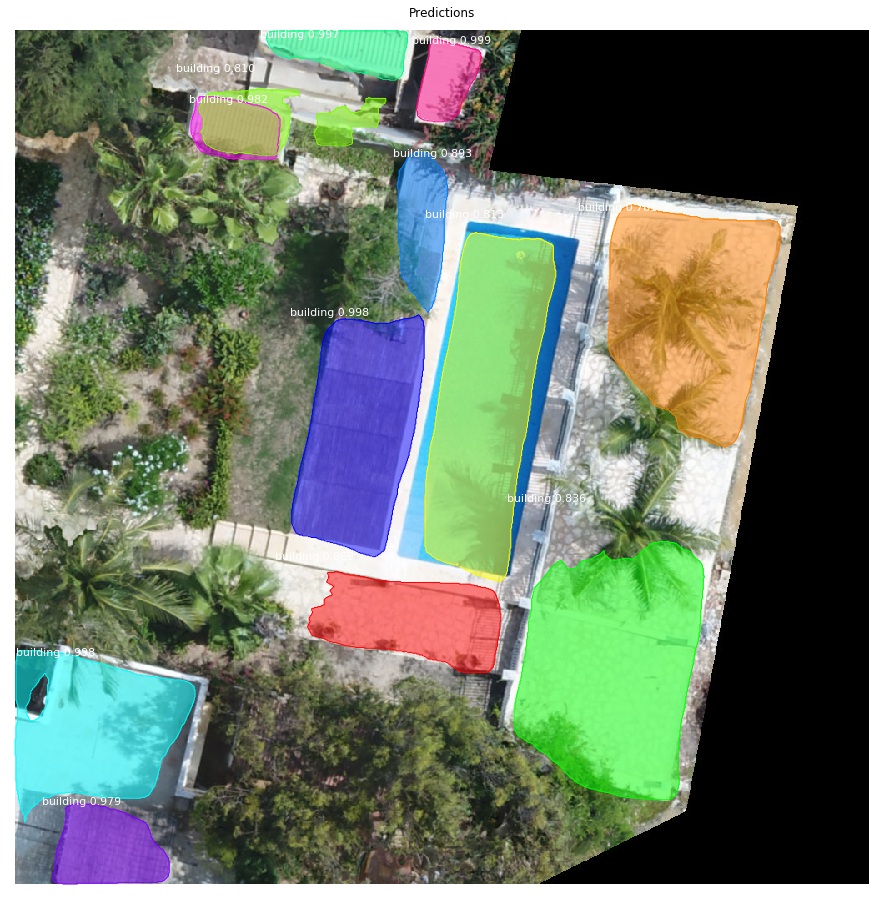

(1024, 1024, 3)


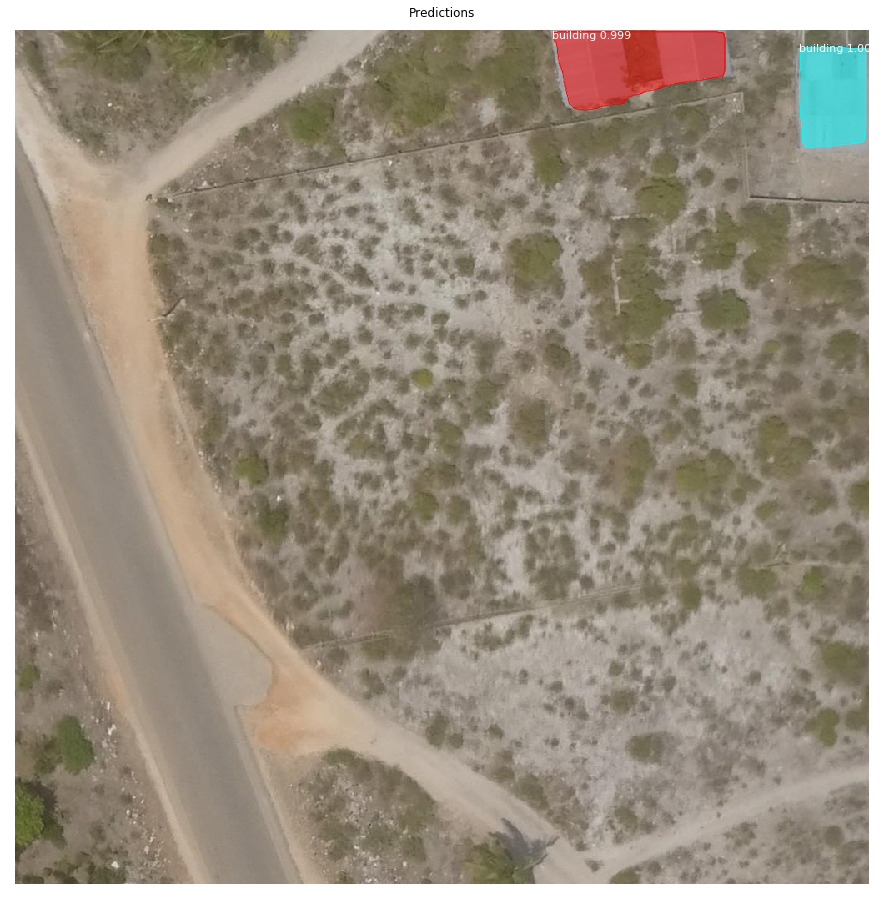

(1024, 1024, 3)


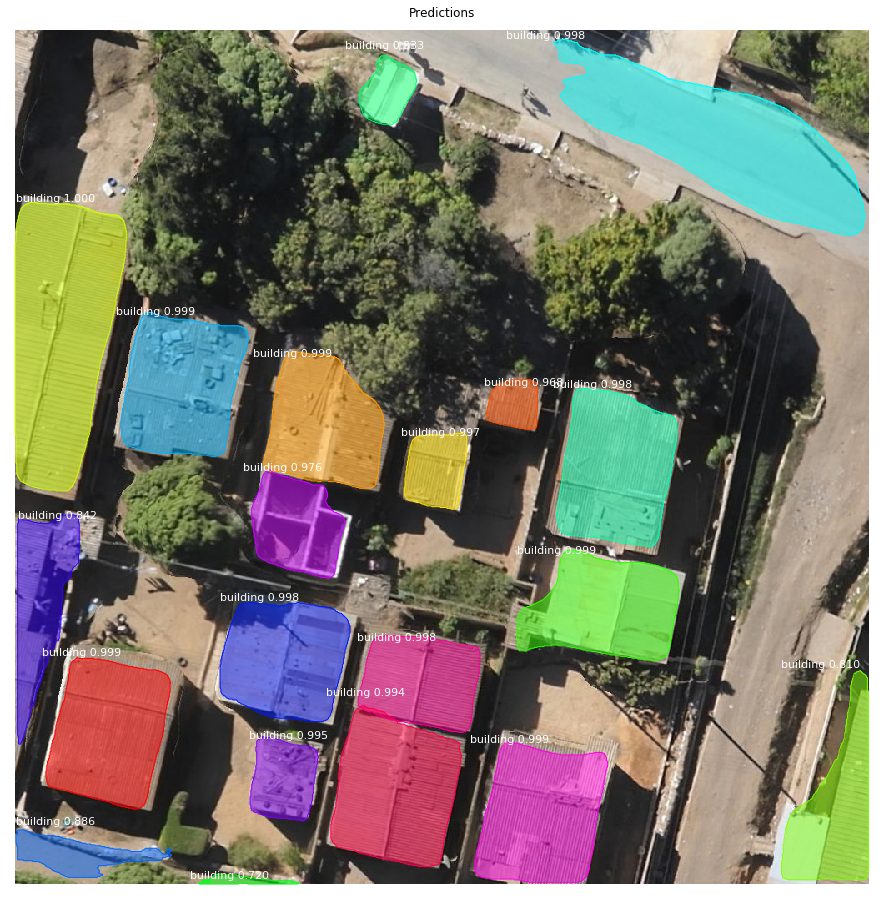

(1024, 1024, 3)


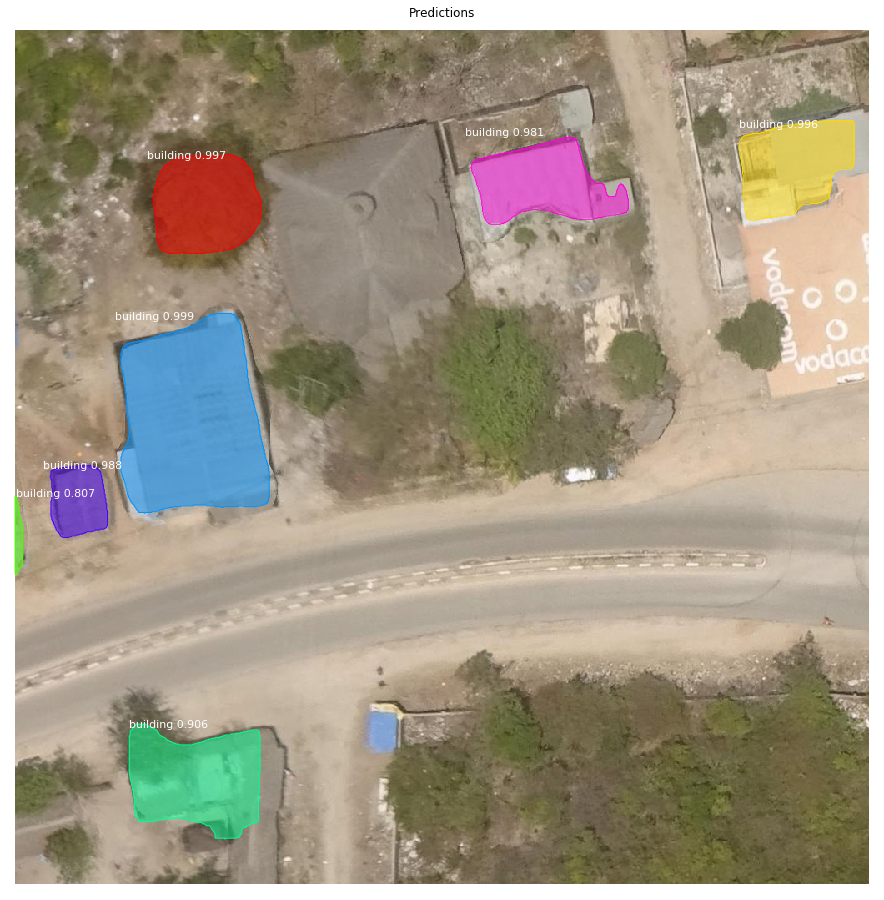

(1024, 1024, 3)


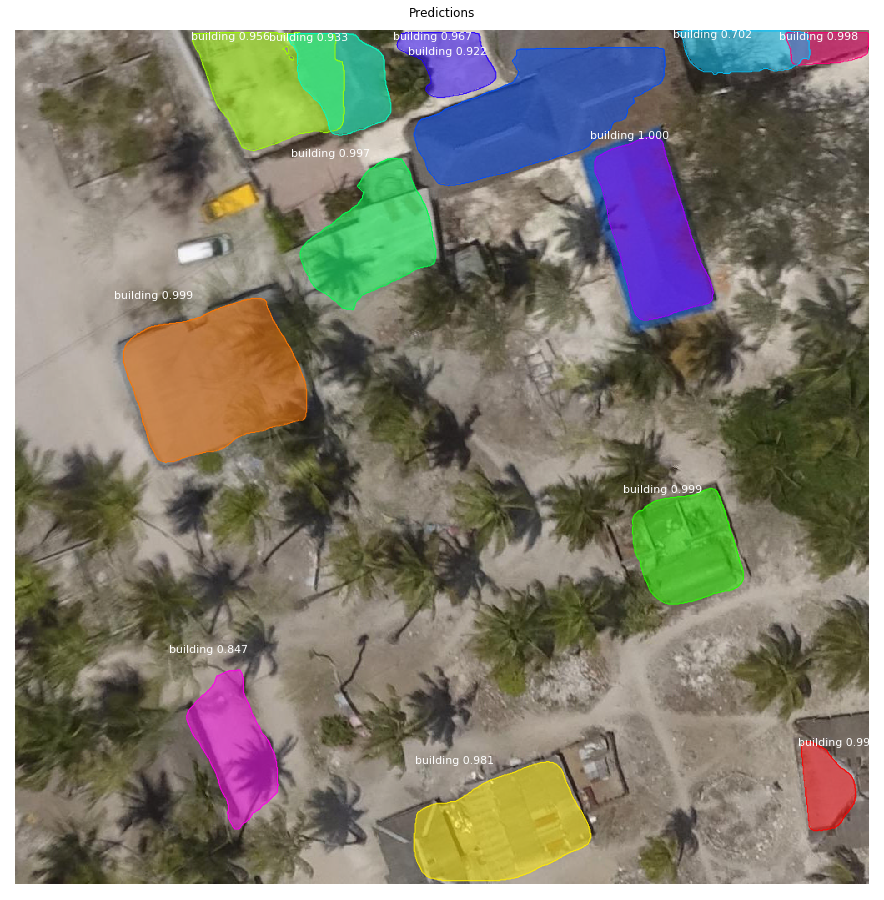

(1024, 1024, 3)

*** No instances to display *** 



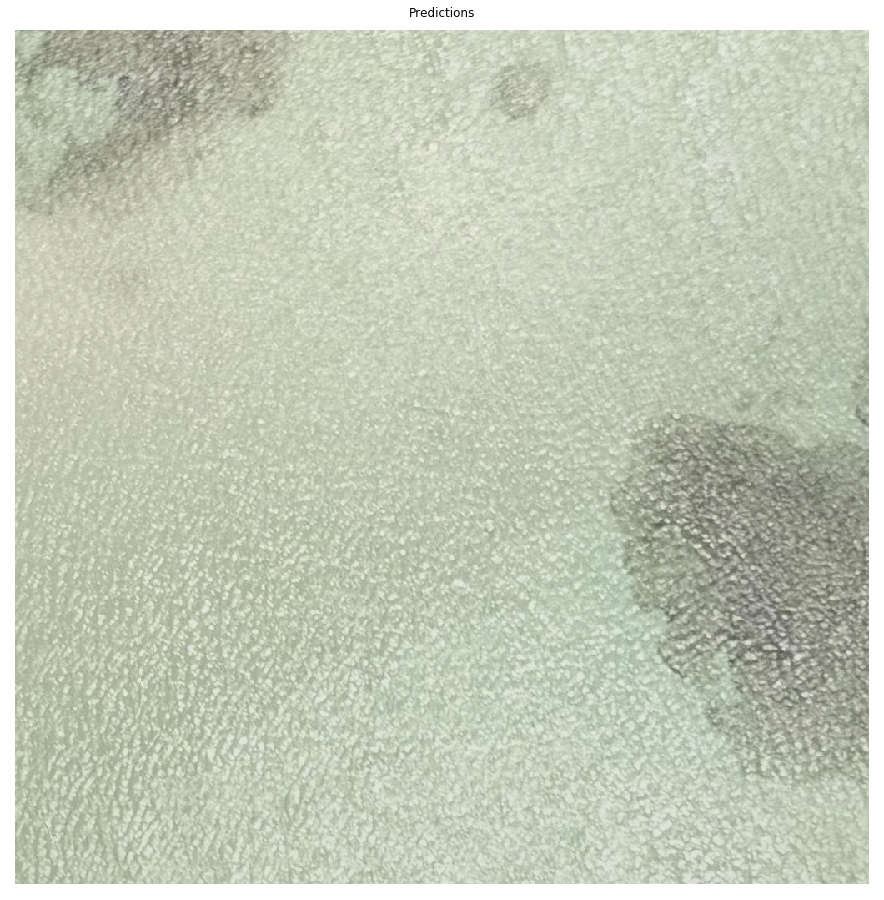

(1024, 1024, 3)


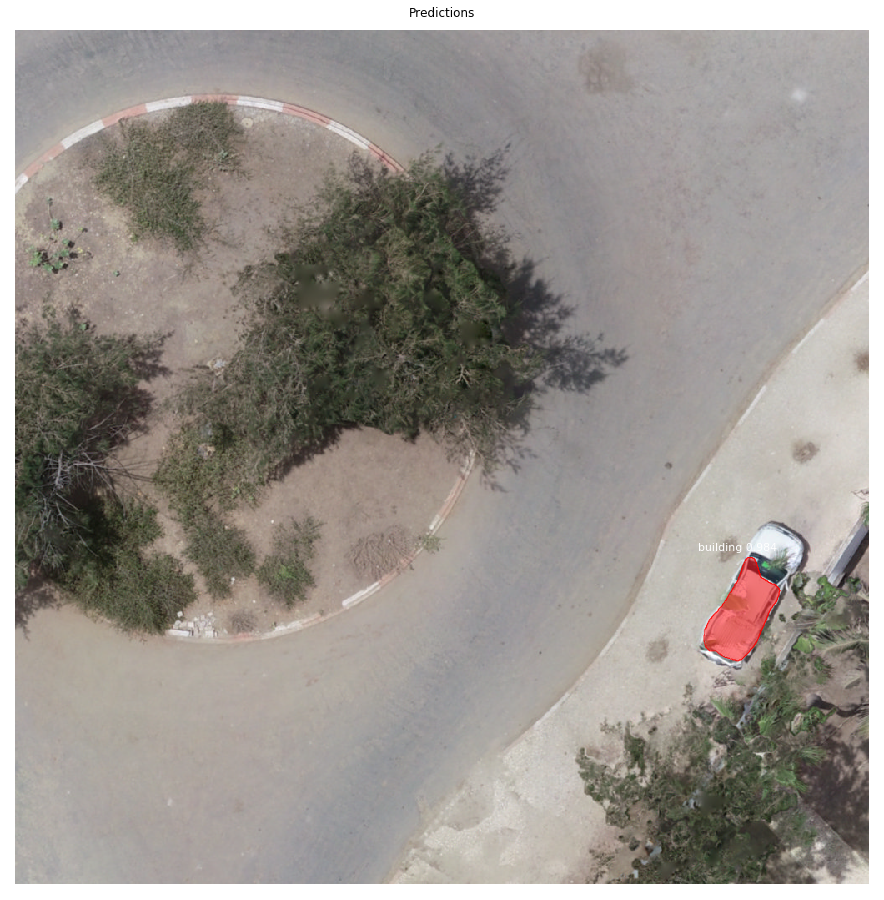

(1024, 1024, 3)


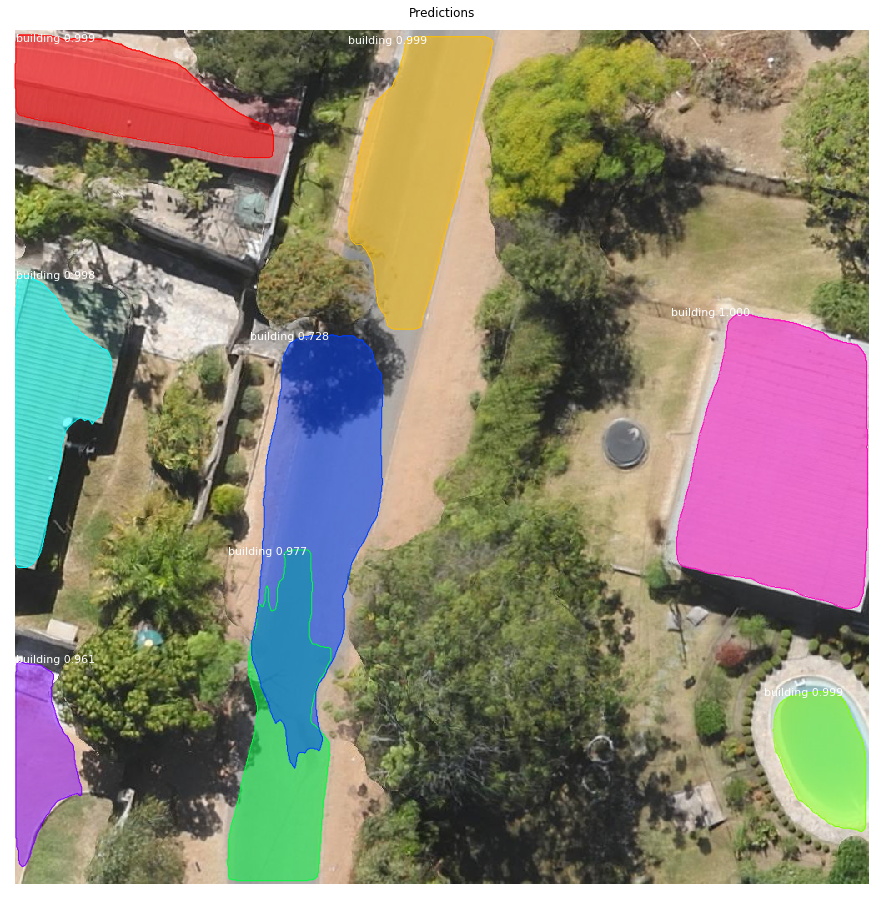

(1024, 1024, 3)


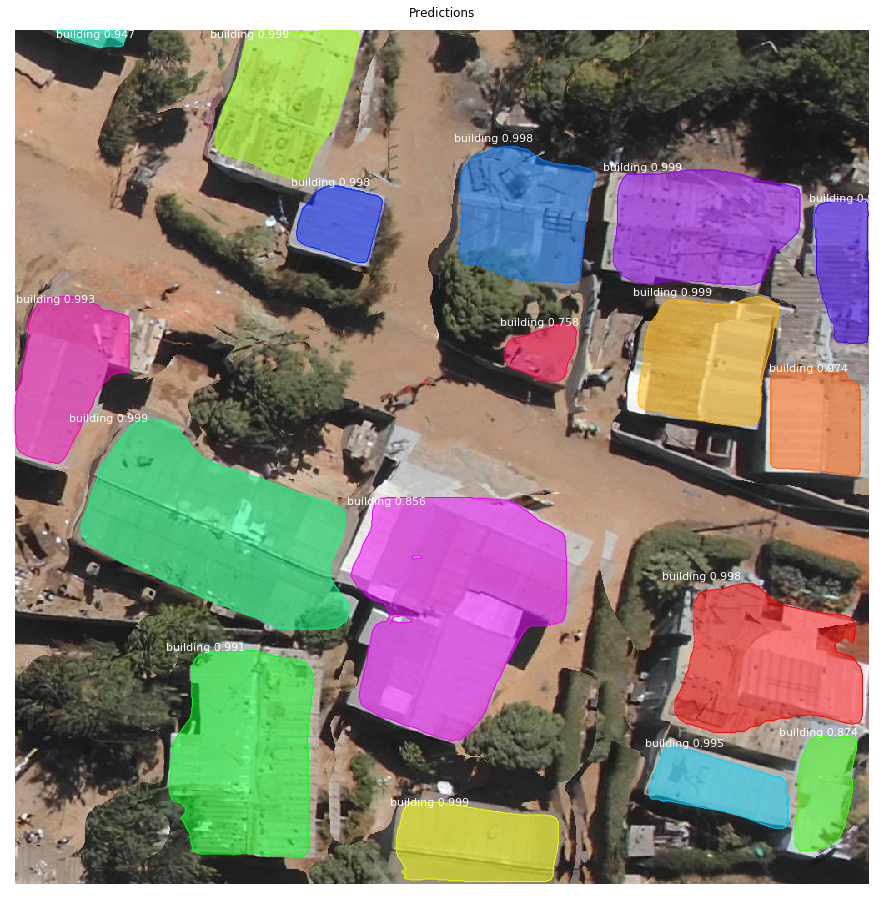

In [61]:
for a in range(20):
    building_detect(model, a)

In [28]:
test_df = np.load('/content/drive/My Drive/Capstone/Open Cities Competition/test_df', allow_pickle=True)
print(test_df['fn'][1])

/content/drive/My Drive/Capstone/Open Cities Competition/Test Data/test/76712a/76712a.tif


Running on /content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/datasets/building/train_4992_a


AssertionError: ignored

In [0]:
test_df = np.load('/content/drive/My Drive/Capstone/Open Cities Competition/test_df', allow_pickle=True)
print(test_df['fn'][0])

/content/drive/My Drive/Capstone/Open Cities Competition/Test Data/test/0a0ab4/0a0ab4.tif


In [0]:
im = PImage.open(test_df.fn.values[1])
image = np.array(im)[:, :, 0:3]
print(test_df.fn.values[1])

/content/drive/My Drive/Capstone/Open Cities Competition/Test Data/test/76712a/76712a.tif


############################################################
#  Convert Command Line to notebook function
#  This is all based on the nucleus.py file
############################################################

In [0]:
"""

Train a new model starting from ImageNet weights using train dataset (which is stage1_train minus validation set)

python3 nucleus.py train --dataset=/path/to/dataset --subset=train --weights=imagenet

***
Train a new model starting from specific weights file using the full stage1_train dataset

python3 nucleus.py train --dataset=/path/to/dataset --subset=stage1_train --weights=/path/to/weights.h5

***
Resume training a model that you had trained earlier

python3 nucleus.py train --dataset=/path/to/dataset --subset=train --weights=last


"""
# The above is the command-line which we will have to mimic below. 

'\npython3 nucleus.py train --dataset=/path/to/dataset --subset=train --weights=imagenet\n'

In [0]:
# Some odd process, seems to consider the value of the total epoch (in the initial case, zero, after the first training session, 20) to be the
# number of epochs run, and so if the selection of epochs within the creation of the model above isn't updated (from 10/20 to, in the second case, 30/40, 
# Then the model simply loads, and then terminates having reached the 'end' of the epochs selected)

In [0]:
config = BuildingsConfig()
config.display()

model = modellib.MaskRCNN(mode="training", config=config,
                          model_dir = DEFAULT_LOGS_DIR)

#weights_path = COCO_WEIGHTS_PATH

weights_path = model.find_last()

# Load weights
print("Loading weights ", weights_path)

model.load_weights(weights_path, by_name=True, exclude=[
            "mrcnn_class_logits", "mrcnn_bbox_fc",
            "mrcnn_bbox", "mrcnn_mask"])

train(model, DATASET_DIR, "train")


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     6
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        200
DETECTION_MIN_CONFIDENCE       0
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 6
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  512
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              none
IMAGE_SHAPE                    [512 512   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                 

/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:49: UserWarning: Using a generator with `use_multi

Train all layers

Starting at epoch 70. LR=0.001

Checkpoint Path: /content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/logs/buildings20200302T1637/mask_rcnn_buildings_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_bra

/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:49: UserWarning: Using a generator with `use_multi

Epoch 71/100
323/323 [==============================] - 1197s 4s/step - loss: 0.7180 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.2520 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.1516 - mrcnn_mask_loss: 0.2167 - val_loss: 1.5647 - val_rpn_class_loss: 0.0752 - val_rpn_bbox_loss: 1.0827 - val_mrcnn_class_loss: 0.0928 - val_mrcnn_bbox_loss: 0.1212 - val_mrcnn_mask_loss: 0.1928

Epoch 72/100
277/323 [========================>.....] - ETA: 2:02 - loss: 0.6414 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.2085 - mrcnn_class_loss: 0.0806 - mrcnn_bbox_loss: 0.1225 - mrcnn_mask_loss: 0.2170

/usr/local/lib/python3.6/dist-packages/keras/utils/data_utils.py:709: UserWarning: An input could not be retrieved. It could be because a worker has died.We do not have any information on the lost sample.
  UserWarning)


323/323 [==============================] - 967s 3s/step - loss: 0.6979 - rpn_class_loss: 0.0170 - rpn_bbox_loss: 0.2638 - mrcnn_class_loss: 0.0803 - mrcnn_bbox_loss: 0.1206 - mrcnn_mask_loss: 0.2161 - val_loss: 0.7095 - val_rpn_class_loss: 0.0076 - val_rpn_bbox_loss: 0.2681 - val_mrcnn_class_loss: 0.0744 - val_mrcnn_bbox_loss: 0.1250 - val_mrcnn_mask_loss: 0.2344
Epoch 73/100
323/323 [==============================] - 1529s 5s/step - loss: 0.6290 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.2065 - mrcnn_class_loss: 0.0819 - mrcnn_bbox_loss: 0.1162 - mrcnn_mask_loss: 0.2136 - val_loss: 0.6507 - val_rpn_class_loss: 0.0169 - val_rpn_bbox_loss: 0.2475 - val_mrcnn_class_loss: 0.0697 - val_mrcnn_bbox_loss: 0.1206 - val_mrcnn_mask_loss: 0.1959
Epoch 74/100
323/323 [==============================] - 1692s 5s/step - loss: 0.6210 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.2111 - mrcnn_class_loss: 0.0788 - mrcnn_bbox_loss: 0.1092 - mrcnn_mask_loss: 0.2107 - val_loss: 0.4484 - val_rpn_class_loss: 

In [0]:
92/323 [================>.............] - ETA: 10:01 - loss: 0.7822 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.2040 - mrcnn_class_loss: 0.1123 - mrcnn_bbox_loss: 0.1781 - mrcnn_mask_loss: 0.2742Process ForkPoolWorker-5:


In [0]:
class BuildingsInferenceConfig(BuildingsConfig):
    # Set batch size to 1 to run one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    # Don't resize imager for inferencing
    IMAGE_RESIZE_MODE = "pad64"
    # Non-max suppression threshold to filter RPN proposals.
    # You can increase this during training to generate more propsals.
    RPN_NMS_THRESHOLD = 0.15

    # Minimum probability value to accept a detected instance
    # ROIs below this threshold are skipped
    DETECTION_MIN_CONFIDENCE = 0.7

    # Non-maximum suppression threshold for detection
    DETECTION_NMS_THRESHOLD = 0.85

In [11]:
config = BuildingsInferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        200
DETECTION_MIN_CONFIDENCE       0
DETECTION_NMS_THRESHOLD        0.85
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  512
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              pad64
IMAGE_SHAPE                    [512 512   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE               

In [12]:
dataset = BuildingDataset()
dataset.load_building(DATASET_DIR, "val")
dataset.prepare()

print("Images: {}\nClasses: {}".format(len(dataset.image_ids), dataset.class_names))

Images: 50
Classes: ['BG', 'building']


In [0]:
model = modellib.MaskRCNN(mode="inference",
                            model_dir=DEFAULT_LOGS_DIR,
                            config=config)


In [14]:
weights_path = model.find_last()

# Load weights
print("Loading weights ", weights_path)
model.load_weights(weights_path, by_name=True)

Loading weights  /content/drive/My Drive/Capstone/Open Cities Competition/Mask_RCNN/logs/buildings20200302T1637/mask_rcnn_buildings_0100.h5
Re-starting from epoch 100


image ID: building.z-TDdPq2NxbziZPghieSUfJRudZd4T48_5yjEdzJHHY (15) z-TDdPq2NxbziZPghieSUfJRudZd4T48_5yjEdzJHHY
Original image shape:  [512 512   3]
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  238.00000  uint8
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.35425  max:    1.22900  float32
gt_class_id              shape: (6,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (6, 4)                min:    0.00000  max:  505.00000  int32
gt_mask                  shape: (512, 512, 6)         min:    0.00000  max:    1.00000  uint8
AP @0.50:	 0.976
AP @0.55:	 0.976
AP @0.60:	 0.976
AP @0.65:	 0.976
AP @0.70:	 0.976
AP @0.75:	 0.976
AP @0.80:	 0.833
AP @0.85:	 0.222
AP @0.90:	 0.083
AP @0.95:	 0.000
A

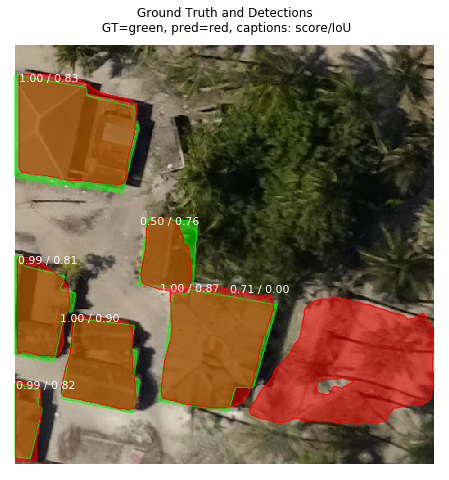

In [26]:
image_id = random.choice(dataset.image_ids)
image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
info = dataset.image_info[image_id]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset.image_reference(image_id)))
print("Original image shape: ", modellib.parse_image_meta(image_meta[np.newaxis,...])["original_image_shape"][0])

# Run object detection
results = model.detect_molded(np.expand_dims(image, 0), np.expand_dims(image_meta, 0), verbose=1)

# Display results
r = results[0]
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

# Compute AP over range 0.5 to 0.95 and print it
utils.compute_ap_range(gt_bbox, gt_class_id, gt_mask,
                       r['rois'], r['class_ids'], r['scores'], r['masks'],
                       verbose=1)

visualize.display_differences(
    image,
    gt_bbox, gt_class_id, gt_mask,
    r['rois'], r['class_ids'], r['scores'], r['masks'],
    dataset.class_names, ax=get_ax(),
    show_box=False, show_mask=True,
    iou_threshold=0.5, score_threshold=0.5)

In [16]:
def compute_batch_ap(dataset, image_ids, verbose=1):
    APs = []
    for image_id in image_ids:
        # Load image
        image, image_meta, gt_class_id, gt_bbox, gt_mask =\
            modellib.load_image_gt(dataset, config,
                                   image_id, use_mini_mask=False)
        # Run object detection
        results = model.detect_molded(image[np.newaxis], image_meta[np.newaxis], verbose=0)
        # Compute AP over range 0.5 to 0.95
        r = results[0]
        ap = utils.compute_ap_range(
            gt_bbox, gt_class_id, gt_mask,
            r['rois'], r['class_ids'], r['scores'], r['masks'],
            verbose=0)
        APs.append(ap)
        if verbose:
            info = dataset.image_info[image_id]
            meta = modellib.parse_image_meta(image_meta[np.newaxis,...])
            print("{:3} {}   AP: {:.2f}".format(
                meta["image_id"][0], meta["original_image_shape"][0], ap))
    return APs

# Run on validation set
limit = 50
APs = compute_batch_ap(dataset, dataset.image_ids[:limit])
print("Mean AP overa {} images: {:.4f}".format(len(APs), np.mean(APs)))

  0 [512 512   3]   AP: 0.56
  1 [512 512   3]   AP: 0.49
  2 [512 512   3]   AP: 0.71
  3 [512 512   3]   AP: 0.38
  4 [512 512   3]   AP: 0.75
  5 [512 512   3]   AP: 0.70
  6 [512 512   3]   AP: 0.47
  7 [512 512   3]   AP: 0.40
  8 [512 512   3]   AP: 0.45
  9 [512 512   3]   AP: 0.46
 10 [512 512   3]   AP: 0.45
 11 [512 512   3]   AP: 0.39
 12 [512 512   3]   AP: 0.80
 13 [512 512   3]   AP: 0.40


KeyboardInterrupt: ignored

In [0]:
# Get anchors and convert to pixel coordinates
anchors = model.get_anchors(image.shape)
anchors = utils.denorm_boxes(anchors, image.shape[:2])
log("anchors", anchors)

# Generate RPN trainig targets
# target_rpn_match is 1 for positive anchors, -1 for negative anchors
# and 0 for neutral anchors.
target_rpn_match, target_rpn_bbox = modellib.build_rpn_targets(
    image.shape, anchors, gt_class_id, gt_bbox, model.config)
log("target_rpn_match", target_rpn_match)
log("target_rpn_bbox", target_rpn_bbox)

positive_anchor_ix = np.where(target_rpn_match[:] == 1)[0]
negative_anchor_ix = np.where(target_rpn_match[:] == -1)[0]
neutral_anchor_ix = np.where(target_rpn_match[:] == 0)[0]
positive_anchors = anchors[positive_anchor_ix]
negative_anchors = anchors[negative_anchor_ix]
neutral_anchors = anchors[neutral_anchor_ix]
log("positive_anchors", positive_anchors)
log("negative_anchors", negative_anchors)
log("neutral anchors", neutral_anchors)

# Apply refinement deltas to positive anchors
refined_anchors = utils.apply_box_deltas(
    positive_anchors,
    target_rpn_bbox[:positive_anchors.shape[0]] * model.config.RPN_BBOX_STD_DEV)
log("refined_anchors", refined_anchors, )

anchors                  shape: (65472, 4)            min: -181.00000  max:  629.00000  int32
target_rpn_match         shape: (65472,)              min:   -1.00000  max:    1.00000  int32
target_rpn_bbox          shape: (128, 4)              min:   -1.68236  max:    1.29979  float64
positive_anchors         shape: (6, 4)                min:  -13.00000  max:  509.00000  int32
negative_anchors         shape: (122, 4)              min:  -23.00000  max:  519.00000  int32
neutral anchors          shape: (65344, 4)            min: -181.00000  max:  629.00000  int32
refined_anchors          shape: (6, 4)                min:    0.00000  max:  505.00000  float32


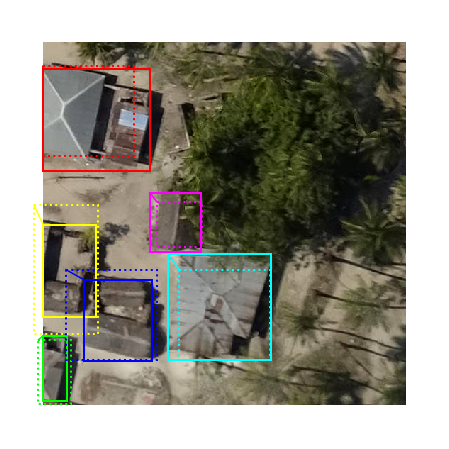

In [0]:
# Display positive anchors before refinement (dotted) and
# after refinement (solid).
visualize.draw_boxes(
    image, ax=get_ax(),
    boxes=positive_anchors,
    refined_boxes=refined_anchors)

In [0]:
# Run RPN sub-graph
pillar = model.keras_model.get_layer("ROI").output  # node to start searching from

# TF 1.4 and 1.9 introduce new versions of NMS. Search for all names to support TF 1.3~1.10
nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression:0")
if nms_node is None:
    nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression/NonMaxSuppressionV2:0")
if nms_node is None: #TF 1.9-1.10
    nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression/NonMaxSuppressionV3:0")

rpn = model.run_graph(image[np.newaxis], [
    ("rpn_class", model.keras_model.get_layer("rpn_class").output),
    ("pre_nms_anchors", model.ancestor(pillar, "ROI/pre_nms_anchors:0")),
    ("refined_anchors", model.ancestor(pillar, "ROI/refined_anchors:0")),
    ("refined_anchors_clipped", model.ancestor(pillar, "ROI/refined_anchors_clipped:0")),
    ("post_nms_anchor_ix", nms_node),
    ("proposals", model.keras_model.get_layer("ROI").output),
], image_metas=image_meta[np.newaxis])

rpn_class                shape: (1, 65472, 2)         min:    0.00000  max:    1.00000  float32
pre_nms_anchors          shape: (1, 6000, 4)          min:   -0.35425  max:    1.22900  float32
refined_anchors          shape: (1, 6000, 4)          min:   -7.52243  max:    7.97982  float32
refined_anchors_clipped  shape: (1, 6000, 4)          min:    0.00000  max:    1.00000  float32
post_nms_anchor_ix       shape: (297,)                min:    0.00000  max: 5990.00000  int32
proposals                shape: (1, 6000, 4)          min:    0.00000  max:    1.00000  float32


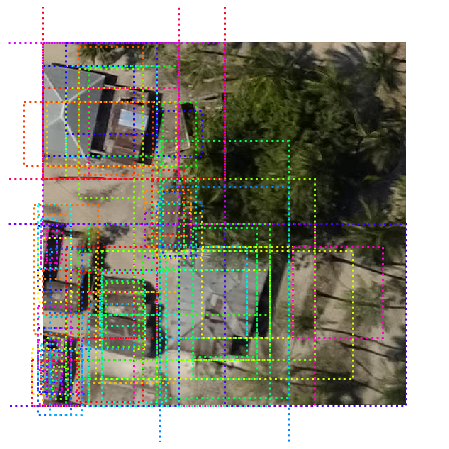

In [0]:
# Show top anchors by score (before refinement)
limit = 100
sorted_anchor_ids = np.argsort(rpn['rpn_class'][:,:,1].flatten())[::-1]
visualize.draw_boxes(image, boxes=anchors[sorted_anchor_ids[:limit]], ax=get_ax())

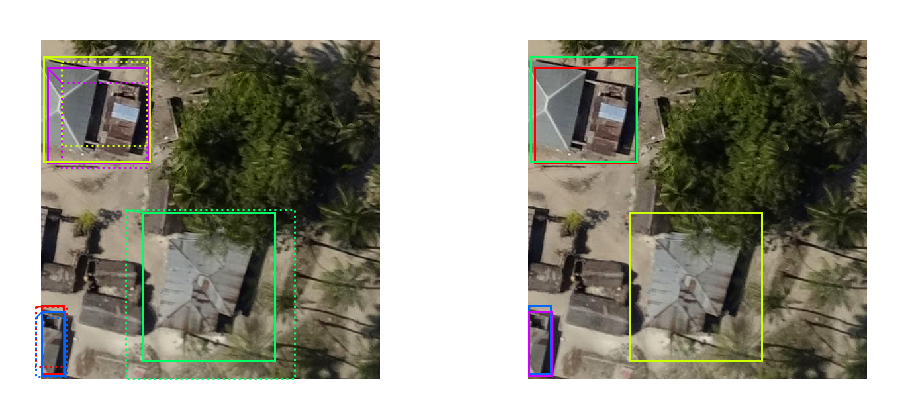

In [0]:
# Show top anchors with refinement. Then with clipping to image boundaries
limit = 5
ax = get_ax(1, 2)
pre_nms_anchors = utils.denorm_boxes(rpn["pre_nms_anchors"][0], image.shape[:2])
refined_anchors = utils.denorm_boxes(rpn["refined_anchors"][0], image.shape[:2])
refined_anchors_clipped = utils.denorm_boxes(rpn["refined_anchors_clipped"][0], image.shape[:2])
visualize.draw_boxes(image, boxes=pre_nms_anchors[:limit],
                     refined_boxes=refined_anchors[:limit], ax=ax[0])
visualize.draw_boxes(image, refined_boxes=refined_anchors_clipped[:limit], ax=ax[1])

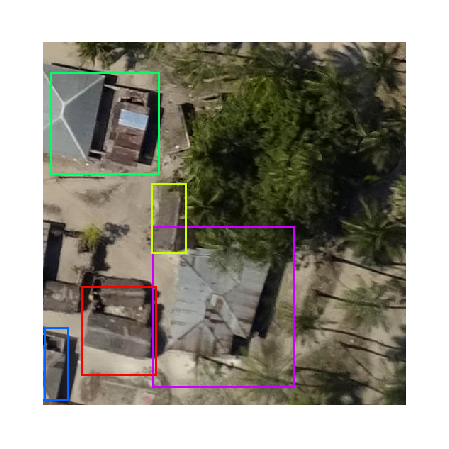

In [0]:
# Show refined anchors after non-max suppression
limit = 5
ixs = rpn["post_nms_anchor_ix"][:limit]
visualize.draw_boxes(image, refined_boxes=refined_anchors_clipped[ixs], ax=get_ax())

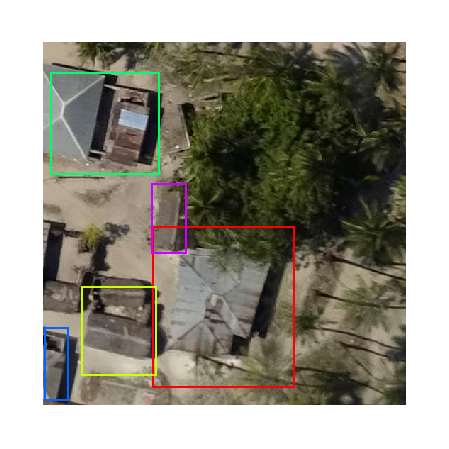

In [0]:
# Show final proposals
# These are the same as the previous step (refined anchors 
# after NMS) but with coordinates normalized to [0, 1] range.
limit = 5
# Convert back to image coordinates for display
# h, w = config.IMAGE_SHAPE[:2]
# proposals = rpn['proposals'][0, :limit] * np.array([h, w, h, w])
visualize.draw_boxes(
    image, ax=get_ax(),
    refined_boxes=utils.denorm_boxes(rpn['proposals'][0, :limit], image.shape[:2]))

In [0]:
# Get input and output to classifier and mask heads.
mrcnn = model.run_graph([image], [
    ("proposals", model.keras_model.get_layer("ROI").output),
    ("probs", model.keras_model.get_layer("mrcnn_class").output),
    ("deltas", model.keras_model.get_layer("mrcnn_bbox").output),
    ("masks", model.keras_model.get_layer("mrcnn_mask").output),
    ("detections", model.keras_model.get_layer("mrcnn_detection").output),
])

proposals                shape: (1, 6000, 4)          min:    0.00000  max:    1.00000  float32
probs                    shape: (1, 6000, 2)          min:    0.00000  max:    1.00000  float32
deltas                   shape: (1, 6000, 2, 4)       min:   -2.16285  max:    3.41771  float32
masks                    shape: (1, 200, 28, 28, 2)   min:    0.00058  max:    0.99996  float32
detections               shape: (1, 200, 6)           min:    0.00000  max:    1.00000  float32


7 detections: ['building' 'building' 'building' 'building' 'building' 'building'
 'building']


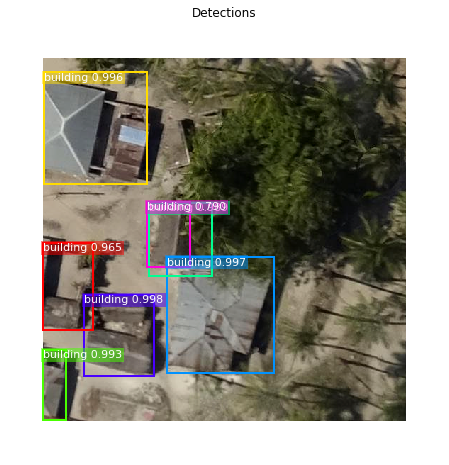

In [0]:
# Get detection class IDs. Trim zero padding.
det_class_ids = mrcnn['detections'][0, :, 4].astype(np.int32)
det_count = np.where(det_class_ids == 0)[0][0]
det_class_ids = det_class_ids[:det_count]
detections = mrcnn['detections'][0, :det_count]

print("{} detections: {}".format(
    det_count, np.array(dataset.class_names)[det_class_ids]))

captions = ["{} {:.3f}".format(dataset.class_names[int(c)], s) if c > 0 else ""
            for c, s in zip(detections[:, 4], detections[:, 5])]
visualize.draw_boxes(
    image, 
    refined_boxes=utils.denorm_boxes(detections[:, :4], image.shape[:2]),
    visibilities=[2] * len(detections),
    captions=captions, title="Detections",
    ax=get_ax())

In [0]:
# Proposals are in normalized coordinates
proposals = mrcnn["proposals"][0]

# Class ID, score, and mask per proposal
roi_class_ids = np.argmax(mrcnn["probs"][0], axis=1)
roi_scores = mrcnn["probs"][0, np.arange(roi_class_ids.shape[0]), roi_class_ids]
roi_class_names = np.array(dataset.class_names)[roi_class_ids]
roi_positive_ixs = np.where(roi_class_ids > 0)[0]

# How many ROIs vs empty rows?
print("{} Valid proposals out of {}".format(np.sum(np.any(proposals, axis=1)), proposals.shape[0]))
print("{} Positive ROIs".format(len(roi_positive_ixs)))

# Class counts
print(list(zip(*np.unique(roi_class_names, return_counts=True))))

783 Valid proposals out of 6000
7 Positive ROIs
[('BG', 5993), ('building', 7)]


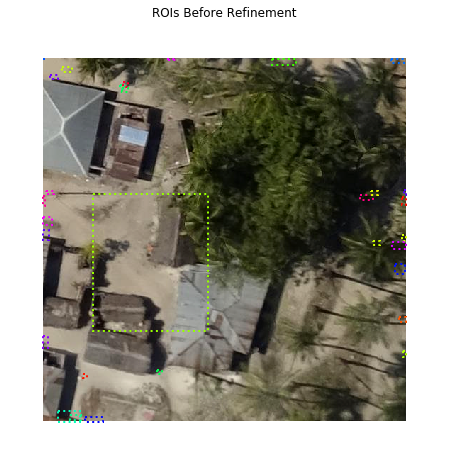

In [0]:
# Display a random sample of proposals.
# Proposals classified as background are dotted, and
# the rest show their class and confidence score.
limit = 200
ixs = np.random.randint(0, proposals.shape[0], limit)
captions = ["{} {:.3f}".format(dataset.class_names[c], s) if c > 0 else ""
            for c, s in zip(roi_class_ids[ixs], roi_scores[ixs])]
visualize.draw_boxes(
    image,
    boxes=utils.denorm_boxes(proposals[ixs], image.shape[:2]),
    visibilities=np.where(roi_class_ids[ixs] > 0, 2, 1),
    captions=captions, title="ROIs Before Refinement",
    ax=get_ax())

roi_bbox_specific        shape: (6000, 4)             min:   -1.00466  max:    2.08827  float32
refined_proposals        shape: (6000, 4)             min:   -0.08124  max:    1.03006  float32


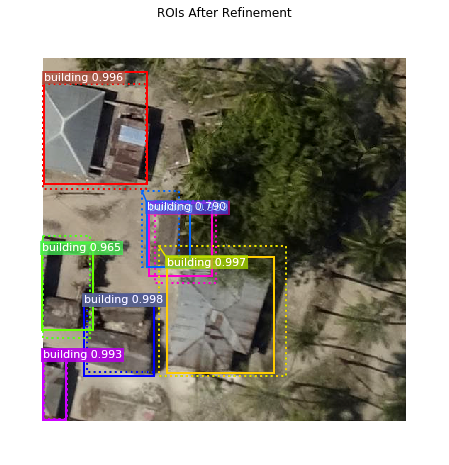

In [0]:
# Class-specific bounding box shifts.
roi_bbox_specific = mrcnn["deltas"][0, np.arange(proposals.shape[0]), roi_class_ids]
log("roi_bbox_specific", roi_bbox_specific)

# Apply bounding box transformations
# Shape: [N, (y1, x1, y2, x2)]
refined_proposals = utils.apply_box_deltas(
    proposals, roi_bbox_specific * config.BBOX_STD_DEV)
log("refined_proposals", refined_proposals)

# Show positive proposals
# ids = np.arange(roi_boxes.shape[0])  # Display all
limit = 15
ids = np.random.randint(0, len(roi_positive_ixs), limit)  # Display random sample
captions = ["{} {:.3f}".format(dataset.class_names[c], s) if c > 0 else ""
            for c, s in zip(roi_class_ids[roi_positive_ixs][ids], roi_scores[roi_positive_ixs][ids])]
visualize.draw_boxes(
    image, ax=get_ax(),
    boxes=utils.denorm_boxes(proposals[roi_positive_ixs][ids], image.shape[:2]),
    refined_boxes=utils.denorm_boxes(refined_proposals[roi_positive_ixs][ids], image.shape[:2]),
    visibilities=np.where(roi_class_ids[roi_positive_ixs][ids] > 0, 1, 0),
    captions=captions, title="ROIs After Refinement")

In [0]:
# Remove boxes classified as background
keep = np.where(roi_class_ids > 0)[0]
print("Keep {} detections:\n{}".format(keep.shape[0], keep))

Keep 7 detections:
[  0   1   2   3   4   5 277]


In [0]:
# Remove low confidence detections
keep = np.intersect1d(keep, np.where(roi_scores >= config.DETECTION_MIN_CONFIDENCE)[0])
print("Remove boxes below {} confidence. Keep {}:\n{}".format(
    config.DETECTION_MIN_CONFIDENCE, keep.shape[0], keep))

Remove boxes below 0 confidence. Keep 7:
[  0   1   2   3   4   5 277]


In [0]:
# Apply per-class non-max suppression
pre_nms_boxes = refined_proposals[keep]
pre_nms_scores = roi_scores[keep]
pre_nms_class_ids = roi_class_ids[keep]

nms_keep = []
for class_id in np.unique(pre_nms_class_ids):
    # Pick detections of this class
    ixs = np.where(pre_nms_class_ids == class_id)[0]
    # Apply NMS
    class_keep = utils.non_max_suppression(pre_nms_boxes[ixs], 
                                            pre_nms_scores[ixs],
                                            config.DETECTION_NMS_THRESHOLD)
    # Map indicies
    class_keep = keep[ixs[class_keep]]
    nms_keep = np.union1d(nms_keep, class_keep)
    print("{:22}: {} -> {}".format(dataset.class_names[class_id][:20], 
                                   keep[ixs], class_keep))

keep = np.intersect1d(keep, nms_keep).astype(np.int32)
print("\nKept after per-class NMS: {}\n{}".format(keep.shape[0], keep))

building              : [  0   1   2   3   4   5 277] -> [  3   1   2   0   4   5 277]

Kept after per-class NMS: 7
[  0   1   2   3   4   5 277]


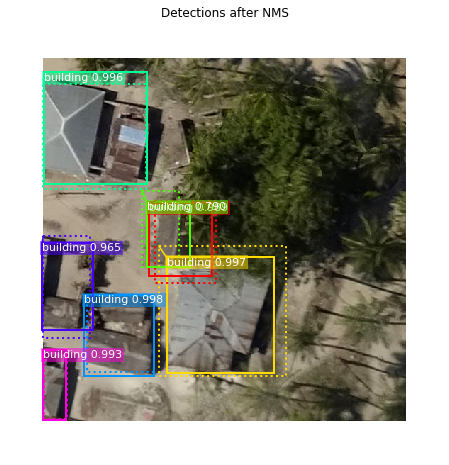

In [0]:
# Show final detections
ixs = np.arange(len(keep))  # Display all
# ixs = np.random.randint(0, len(keep), 10)  # Display random sample
captions = ["{} {:.3f}".format(dataset.class_names[c], s) if c > 0 else ""
            for c, s in zip(roi_class_ids[keep][ixs], roi_scores[keep][ixs])]
visualize.draw_boxes(
    image,
    boxes=utils.denorm_boxes(proposals[keep][ixs], image.shape[:2]),
    refined_boxes=utils.denorm_boxes(refined_proposals[keep][ixs], image.shape[:2]),
    visibilities=np.where(roi_class_ids[keep][ixs] > 0, 1, 0),
    captions=captions, title="Detections after NMS",
    ax=get_ax())

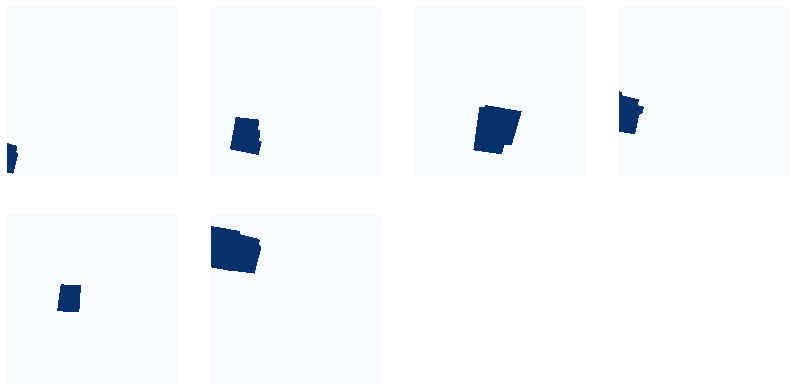

In [0]:
limit = 8
display_images(np.transpose(gt_mask[..., :limit], [2, 0, 1]), cmap="Blues")

In [0]:
# Get predictions of mask head
mrcnn = model.run_graph([image], [
    ("detections", model.keras_model.get_layer("mrcnn_detection").output),
    ("masks", model.keras_model.get_layer("mrcnn_mask").output),
])

# Get detection class IDs. Trim zero padding.
det_class_ids = mrcnn['detections'][0, :, 4].astype(np.int32)
det_count = np.where(det_class_ids == 0)[0][0]
det_class_ids = det_class_ids[:det_count]

print("{} detections: {}".format(
    det_count, np.array(dataset.class_names)[det_class_ids]))

detections               shape: (1, 200, 6)           min:    0.00000  max:    1.00000  float32
masks                    shape: (1, 200, 28, 28, 2)   min:    0.00058  max:    0.99996  float32
7 detections: ['building' 'building' 'building' 'building' 'building' 'building'
 'building']


In [0]:
# Masks
det_boxes = utils.denorm_boxes(mrcnn["detections"][0, :, :4], image.shape[:2])
det_mask_specific = np.array([mrcnn["masks"][0, i, :, :, c] 
                              for i, c in enumerate(det_class_ids)])
det_masks = np.array([utils.unmold_mask(m, det_boxes[i], image.shape)
                      for i, m in enumerate(det_mask_specific)])
log("det_mask_specific", det_mask_specific)
log("det_masks", det_masks)

det_mask_specific        shape: (7, 28, 28)           min:    0.00058  max:    0.99996  float32
det_masks                shape: (7, 512, 512)         min:    0.00000  max:    1.00000  bool


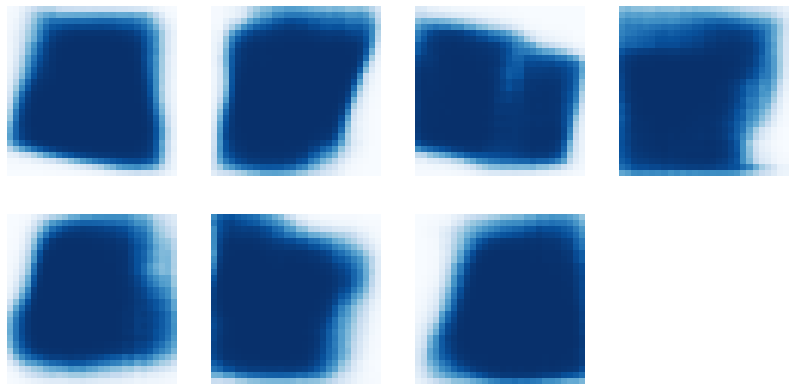

In [0]:
display_images(det_mask_specific[:] * 255, cmap="Blues", interpolation="none")

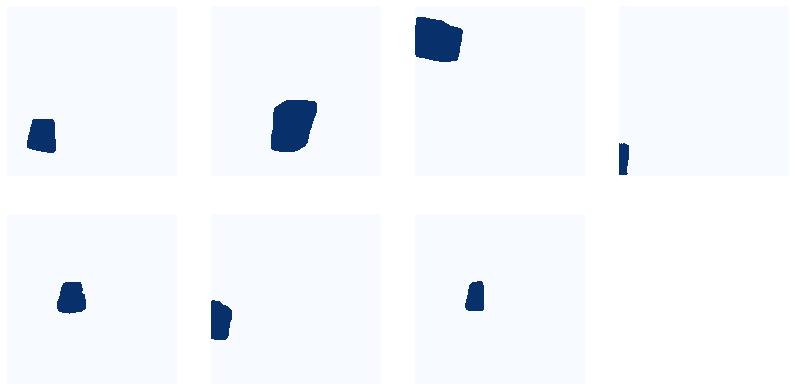

In [0]:
display_images(det_masks[:] * 255, cmap="Blues", interpolation="none")

In [0]:
# Get activations of a few sample layers
activations = model.run_graph([image], [
    ("input_image",        tf.identity(model.keras_model.get_layer("input_image").output)),
    ("res2c_out",          model.keras_model.get_layer("res2c_out").output),
    ("res3c_out",          model.keras_model.get_layer("res3c_out").output),
    ("rpn_bbox",           model.keras_model.get_layer("rpn_bbox").output),
    ("roi",                model.keras_model.get_layer("ROI").output),
])

input_image              shape: (1, 512, 512, 3)      min: -128.77000  max:  123.46000  float32
res2c_out                shape: (1, 128, 128, 256)    min:    0.00000  max:   21.83395  float32
res3c_out                shape: (1, 64, 64, 512)      min:    0.00000  max:   21.45160  float32
rpn_bbox                 shape: (1, 65472, 4)         min:  -12.95115  max:  104.05435  float32
roi                      shape: (1, 6000, 4)          min:    0.00000  max:    1.00000  float32


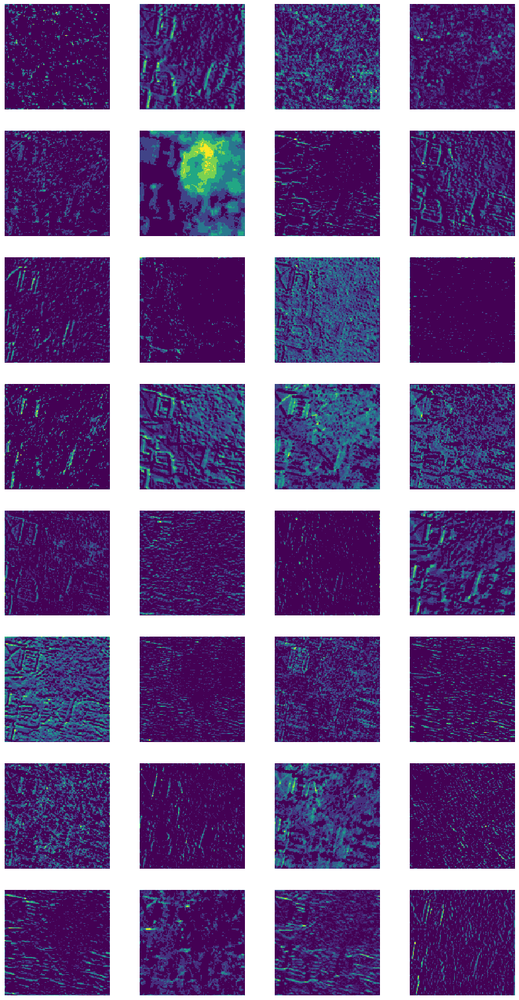

In [0]:
# Backbone feature map
display_images(np.transpose(activations["res2c_out"][0,:,:,:32], [2, 0, 1]), cols=4)

image ID: building.z-TDdPq2NxbziZPghieSUfJRudZd4T48_5yjEdzJHHY (15) z-TDdPq2NxbziZPghieSUfJRudZd4T48_5yjEdzJHHY
Original image shape:  [512 512   3]
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  238.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min:    0.00000  max:  238.00000  uint8
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.35425  max:    1.22900  float32
gt_class_id              shape: (6,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (6, 4)                min:    0.00000  max:  505.00000  int32
gt_mask                  shape: (512, 512, 6)         min:    0.00000  max:    1.00000  uint8
AP @0.50:	 0.833
AP @0.55:	 0.833
AP @0.60:	 0.833
AP @0.65:	 0.833
AP @0.70:	 0.667
AP @0.75:	 0.375
AP @0.80:	 0.375
AP @0.85:	 0.222
AP @0.90:	 0.083
AP @0.95:	 0.000
A

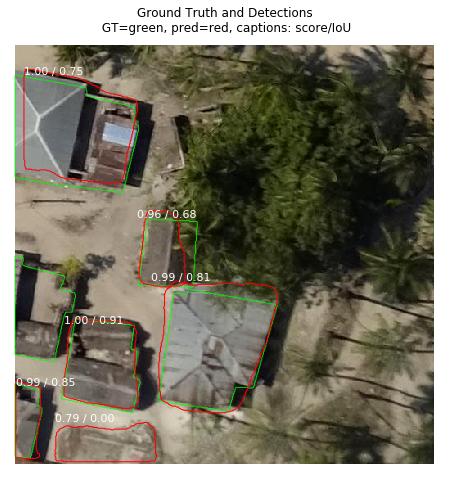

In [0]:
image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
info = dataset.image_info[image_id]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset.image_reference(image_id)))
print("Original image shape: ", modellib.parse_image_meta(image_meta[np.newaxis,...])["original_image_shape"][0])

# Run object detection
results = model.detect_molded(np.expand_dims(image, 0), np.expand_dims(image_meta, 0), verbose=1)

# Display results
r = results[0]
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

# Compute AP over range 0.5 to 0.95 and print it
utils.compute_ap_range(gt_bbox, gt_class_id, gt_mask,
                       r['rois'], r['class_ids'], r['scores'], r['masks'],
                       verbose=1)

visualize.display_differences(
    image,
    gt_bbox, gt_class_id, gt_mask,
    r['rois'], r['class_ids'], 
    r['scores'], r['masks'],
    dataset.class_names, ax=get_ax(),
    show_box=False, show_mask=False,
    iou_threshold=0.5, score_threshold=0.5)